# 1. 라이브러리 로드

In [ ]:
!pip install numpy==1.24.3 pandas==2.2.2 scipy --force-reinstall

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 21.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.0/13.0 MB 29.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.7/37.7 MB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.9/229.9 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 509.2/509.2 kB 18.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 347.8/347.8 kB 11.3 MB/s eta 0:00:00
  Attempting uninstall: pytz
    Found existing installation: pytz 2025.2
    Uninstalling pytz-2025.2:
      Successfully uninstalled pytz-2025.2
  Attempting uninstall: tzdata
    Found existing installation: tzdata 2025.2
    Uninstalling tzdata-2025.2:
      Successfully uninstalled tzdata-2025.2
  Attempting uninstall: six
    Found existing installation: six 1.17.0
    Uninstalling six-1.17.0:
      Successfully uninstalled six-1.1

In [ ]:
!pip install mediapipe

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.6/35.6 MB 52.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.9/294.9 kB 20.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 85.7 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 5.29.5
    Uninstalling protobuf-5.29.5:
      Successfully uninstalled protobuf-5.29.5
  Attempting uninstall: numpy
    Found existing installation: numpy 1.24.3
    Uninstalling numpy-1.24.3:
      Successfully uninstalled numpy-1.24.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
grpcio-status 1.71.0 requires protobuf<6.0dev,>=5.26.1, but you have protobuf 4.25.8 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompa

In [ ]:
import os
import cv2
import math
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import mediapipe as mp
import gc  # ✅ Garbage Collector 추가
from tqdm import tqdm
from concurrent.futures import ThreadPoolExecutor

# 2. 데이터 로드 및 전처리

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
mar_df = pd.read_csv("/content/drive/MyDrive/DMS/data/features/mar_ear_final/mar_ear_results.csv")
mar_df.head()

<ipython-input-23-cf372ea36f81>:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  mar_df = pd.read_csv("/content/drive/MyDrive/DMS/data/features/mar_ear_final/mar_ear_results.csv")


,frame_path,label,camera,clip_id,frame_no,MAR,MAR_horiz_dist,MAR_vert_mean,mouth_landmarks,EAR,EAR_horiz_dist,EAR_vert_mean,eyes_landmarks
0,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,0,0.003843,0.092017,0.000354,"[[0.6790302395820618, 0.5664031505584717], [0....",0.120216,0.051741,0.012074,"[[0.7544835209846497, 0.4115215837955475], [0...."
1,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,1,0.004076,0.091086,0.000371,"[[0.6802352666854858, 0.5672312378883362], [0....",0.124289,0.050414,0.012138,"[[0.7565779685974121, 0.4120103120803833], [0...."
2,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,2,0.004031,0.093789,0.000378,"[[0.6815208196640015, 0.5677939653396606], [0....",0.116291,0.051359,0.011561,"[[0.757136881351471, 0.4125784635543823], [0.7..."
3,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,3,0.005841,0.091469,0.000534,"[[0.6822372674942017, 0.5668578147888184], [0....",0.130911,0.049372,0.012457,"[[0.7575653195381165, 0.4115835130214691], [0...."
4,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,4,0.032160,0.093394,0.003004,"[[0.6810718774795532, 0.5672640204429626], [0....",0.126964,0.051338,0.012637,"[[0.7571709156036377, 0.41263824701309204], [0..."


In [ ]:
mar_df.shape

(145665, 13)

In [ ]:
mar_df.columns

Index(['frame_path', 'label', 'camera', 'clip_id', 'frame_no', 'MAR',
       'MAR_horiz_dist', 'MAR_vert_mean', 'mouth_landmarks', 'EAR',
       'EAR_horiz_dist', 'EAR_vert_mean', 'eyes_landmarks'],
      dtype='object')

In [ ]:
mar_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145665 entries, 0 to 145664
Data columns (total 13 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   frame_path       145665 non-null  object 
 1   label            145665 non-null  object 
 2   camera           10190 non-null   object 
 3   clip_id          145665 non-null  object 
 4   frame_no         145665 non-null  int64  
 5   MAR              145203 non-null  float64
 6   MAR_horiz_dist   145203 non-null  float64
 7   MAR_vert_mean    145203 non-null  float64
 8   mouth_landmarks  145203 non-null  object 
 9   EAR              145203 non-null  float64
 10  EAR_horiz_dist   145203 non-null  float64
 11  EAR_vert_mean    145203 non-null  float64
 12  eyes_landmarks   145203 non-null  object 
dtypes: float64(6), int64(1), object(6)
memory usage: 14.4+ MB


In [ ]:
yawn_text = mar_df[mar_df['label'].isin(['text', 'yawn'])]
yawn_text.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21303 entries, 0 to 144774
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   frame_path       21303 non-null  object 
 1   label            21303 non-null  object 
 2   camera           6153 non-null   object 
 3   clip_id          21303 non-null  object 
 4   frame_no         21303 non-null  int64  
 5   MAR              21288 non-null  float64
 6   MAR_horiz_dist   21288 non-null  float64
 7   MAR_vert_mean    21288 non-null  float64
 8   mouth_landmarks  21288 non-null  object 
 9   EAR              21288 non-null  float64
 10  EAR_horiz_dist   21288 non-null  float64
 11  EAR_vert_mean    21288 non-null  float64
 12  eyes_landmarks   21288 non-null  object 
dtypes: float64(6), int64(1), object(6)
memory usage: 2.3+ MB


In [42]:
yawn_text['MAR'].isnull().sum()

15

### 12프레임 drop_columns 추가

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/DMS/data/final_df_12.csv")
# df_24f = pd.read_csv("/content/drive/MyDrive/DMS/data/final_df_24.csv")

In [ ]:
print(df.shape)
df.head()

(139992, 7)


,frame_path,label,camera,clip_id,frame_no,dataset,groups_12
0,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,0,yawDD,0
1,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,1,yawDD,0
2,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,2,yawDD,0
3,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,3,yawDD,0
4,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,4,yawDD,0


In [ ]:
# 1. df + mar_df 결합
merged_df = df.merge(mar_df[['frame_path', 'MAR',
       'MAR_horiz_dist', 'MAR_vert_mean', 'mouth_landmarks', 'EAR',
       'EAR_horiz_dist', 'EAR_vert_mean', 'eyes_landmarks']], on=['frame_path'], how='left')

# 2. 결측 확인 컬럼 추가
merged_df['is_missing'] = merged_df['MAR'].isna()

# 3. group_id 기준으로 결측 streak 분석
results = []
for group_id, group in merged_df.groupby(['label', 'clip_id','groups_12']):
    is_missing = group.sort_values('frame_no')['is_missing'].tolist()

    # 연속 결측 구간 분석
    streaks = []
    count = 0
    for val in is_missing:
        if val:
            count += 1
        else:
            if count > 0:
                streaks.append(count)
                count = 0
    if count > 0:
        streaks.append(count)

    # 결과 저장
    results.append({
        'label': group_id[0],
        'clip_id': group_id[1],
        'groups_12': group_id[2],
        'group_': group_id,
        'clip_id': group['clip_id'].iloc[0],
        'max_missing_streak': max(streaks) if streaks else 0,
        'num_missing_streaks': len(streaks),
    })

# 4. 결과 정리
group_streak_df = pd.DataFrame(results)
group_streak_df

,label,clip_id,groups_12,group_,max_missing_streak,num_missing_streaks
0,normal,1-FemaleNoGlasses-Yawning-clip-1,0,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 0)",0,0
1,normal,1-FemaleNoGlasses-Yawning-clip-1,1,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 1)",0,0
2,normal,1-FemaleNoGlasses-Yawning-clip-1,2,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 2)",0,0
3,normal,1-MaleNoGlasses-Yawning-clip-0,0,"(normal, 1-MaleNoGlasses-Yawning-clip-0, 0)",0,0
4,normal,1-MaleNoGlasses-Yawning-clip-2,0,"(normal, 1-MaleNoGlasses-Yawning-clip-2, 0)",0,0
...,...,...,...,...,...,...
11661,yawn,face_2019-03-14-14;26;17_1_1.avi,1,"(yawn, face_2019-03-14-14;26;17_1_1.avi, 1)",0,0
11662,yawn,face_2019-03-14-14;26;17_1_1.avi,2,"(yawn, face_2019-03-14-14;26;17_1_1.avi, 2)",0,0
11663,yawn,face_2019-03-14-14;26;17_1_2.avi,0,"(yawn, face_2019-03-14-14;26;17_1_2.avi, 0)",0,0
11664,yawn,face_2019-03-14-14;26;17_1_2.avi,1,"(yawn, face_2019-03-14-14;26;17_1_2.avi, 1)",0,0


In [ ]:
# max_missing_streak 값별로 개수 집계
streak_count_df = group_streak_df['max_missing_streak'].value_counts().sort_index().reset_index()
streak_count_df.columns = ['max_missing_streak', 'num_groups']
streak_count_df

,max_missing_streak,num_groups
0,0,11502
1,1,81
2,2,36
3,3,21
4,4,11
5,5,4
6,6,7
7,7,2
8,8,1
9,10,1


In [ ]:
# 5. 드랍 대상 여부 컬럼 추가
group_streak_df['is_mar_ear_streak5plus'] = group_streak_df['max_missing_streak'] >= 5
group_streak_df.head()


,label,clip_id,groups_12,group_,max_missing_streak,num_missing_streaks,is_mar_ear_streak5plus
0,normal,1-FemaleNoGlasses-Yawning-clip-1,0,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 0)",0,0,False
1,normal,1-FemaleNoGlasses-Yawning-clip-1,1,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 1)",0,0,False
2,normal,1-FemaleNoGlasses-Yawning-clip-1,2,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 2)",0,0,False
3,normal,1-MaleNoGlasses-Yawning-clip-0,0,"(normal, 1-MaleNoGlasses-Yawning-clip-0, 0)",0,0,False
4,normal,1-MaleNoGlasses-Yawning-clip-2,0,"(normal, 1-MaleNoGlasses-Yawning-clip-2, 0)",0,0,False


In [ ]:
merged_df = merged_df.merge(group_streak_df, on=['label', 'clip_id', 'groups_12'], how='left')
merged_df

,frame_path,label,camera,clip_id,frame_no,dataset,groups_12,MAR,MAR_horiz_dist,MAR_vert_mean,mouth_landmarks,EAR,EAR_horiz_dist,EAR_vert_mean,eyes_landmarks,is_missing,group_,max_missing_streak,num_missing_streaks,is_mar_ear_streak5plus
0,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,0,yawDD,0,0.012913,0.077751,0.001004,"[[0.6879969835281372, 0.5694696307182312], [0....",0.161395,0.047641,0.014085,"[[0.7607617378234863, 0.4116917848587036], [0....",False,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 0)",0,0,False
1,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,1,yawDD,0,0.020873,0.075224,0.001570,"[[0.6815370321273804, 0.5687231421470642], [0....",0.152588,0.048162,0.013940,"[[0.7577546834945679, 0.40831711888313293], [0...",False,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 0)",0,0,False
2,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,2,yawDD,0,0.071455,0.081726,0.005840,"[[0.6768521666526794, 0.563867449760437], [0.6...",0.159343,0.047281,0.013904,"[[0.7555350065231323, 0.4042552411556244], [0....",False,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 0)",0,0,False
3,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,3,yawDD,0,0.102460,0.072981,0.007478,"[[0.6829803586006165, 0.5668616890907288], [0....",0.162376,0.045473,0.013623,"[[0.7570106387138367, 0.4027590751647949], [0....",False,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 0)",0,0,False
4,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,4,yawDD,0,0.202449,0.069644,0.014099,"[[0.6937663555145264, 0.5600349307060242], [0....",0.164114,0.049113,0.015007,"[[0.7653884887695312, 0.4025568962097168], [0....",False,"(normal, 1-FemaleNoGlasses-Yawning-clip-1, 0)",0,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139987,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,31,DMD,2,0.054325,0.056845,0.003088,"[[0.44413378834724426, 0.6351353526115417], [0...",0.102960,0.033662,0.006922,"[[0.49295395612716675, 0.5448129773139954], [0...",False,"(yawn, face_2019-03-14-14;26;17_1_2.avi, 2)",0,0,False
139988,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,32,DMD,2,0.135679,0.052650,0.007144,"[[0.4613957405090332, 0.6372644305229187], [0....",0.104257,0.033511,0.006995,"[[0.5052523612976074, 0.5478636622428894], [0....",False,"(yawn, face_2019-03-14-14;26;17_1_2.avi, 2)",0,0,False
139989,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,33,DMD,2,0.103187,0.057156,0.005898,"[[0.46782296895980835, 0.6412728428840637], [0...",0.103494,0.035309,0.007308,"[[0.514333188533783, 0.5522364377975464], [0.5...",False,"(yawn, face_2019-03-14-14;26;17_1_2.avi, 2)",0,0,False
139990,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,34,DMD,2,0.238439,0.050842,0.012123,"[[0.4745681881904602, 0.6434462666511536], [0....",0.110059,0.033687,0.007423,"[[0.5239902138710022, 0.5539049506187439], [0....",False,"(yawn, face_2019-03-14-14;26;17_1_2.avi, 2)",0,0,False


In [ ]:
merged_df[(merged_df['max_missing_streak']>2) & (merged_df['max_missing_streak']<5)].iloc[-1]['clip_id']

'gZ-31(File25)_s4_face_2019-04-03-09;04;29_31_7.avi'

In [ ]:
merged_df.columns

Index(['frame_path', 'label', 'camera', 'clip_id', 'frame_no', 'dataset',
       'groups_12', 'MAR', 'MAR_horiz_dist', 'MAR_vert_mean',
       'mouth_landmarks', 'EAR', 'EAR_horiz_dist', 'EAR_vert_mean',
       'eyes_landmarks', 'is_missing', 'group_', 'max_missing_streak',
       'num_missing_streaks', 'is_mar_ear_streak5plus'],
      dtype='object')

In [ ]:
col_names =['frame_path', 'label', 'camera', 'clip_id', 'frame_no', 'dataset',
       'groups_12', 'MAR', 'MAR_horiz_dist', 'MAR_vert_mean',
       'mouth_landmarks', 'EAR', 'EAR_horiz_dist', 'EAR_vert_mean',
       'eyes_landmarks','is_mar_ear_streak5plus']

In [ ]:
merged_df[col_names].to_csv('/content/drive/MyDrive/DMS/data/EDA/mar_ear_final/final_df_12_mar_ear.csv', index=False)

### 24프레임

In [ ]:
import pandas as pd

def process_mar_ear_streak(base_df, mar_df, group_col_name, save_path):
    """MAR/EAR 결측 구간 분석 후 플래그 추가 및 저장"""

    # 1. MAR/EAR 관련 컬럼 병합
    mar_ear_cols = [
        'frame_path', 'MAR', 'MAR_horiz_dist', 'MAR_vert_mean', 'mouth_landmarks',
        'EAR', 'EAR_horiz_dist', 'EAR_vert_mean', 'eyes_landmarks'
    ]
    merged_df = base_df.merge(mar_df[mar_ear_cols], on='frame_path', how='left')

    # 2. 결측 여부 확인
    merged_df['is_missing'] = merged_df['MAR'].isna()

    # 3. 그룹별 연속 결측 분석
    results = []
    group_cols = ['label', 'clip_id', group_col_name]
    for group_id, group in merged_df.groupby(group_cols):
        is_missing = group.sort_values('frame_no')['is_missing'].tolist()
        streaks, count = [], 0
        for val in is_missing:
            if val:
                count += 1
            else:
                if count > 0:
                    streaks.append(count)
                    count = 0
        if count > 0:
            streaks.append(count)

        results.append({
            'label': group_id[0],
            'clip_id': group_id[1],
            group_col_name: group_id[2],
            'max_missing_streak': max(streaks) if streaks else 0,
            'num_missing_streaks': len(streaks),
        })

    group_streak_df = pd.DataFrame(results)

    # 4. 5프레임 이상 연속 결측 여부 플래그 추가
    group_streak_df['is_mar_ear_streak5plus'] = group_streak_df['max_missing_streak'] >= 5

    # 5. 병합 및 결측 False 처리
    merged_df = merged_df.merge(
        group_streak_df[['label', 'clip_id', group_col_name, 'is_mar_ear_streak5plus']],
        on=['label', 'clip_id', group_col_name],
        how='left'
    )
    merged_df['is_mar_ear_streak5plus'] = merged_df['is_mar_ear_streak5plus'].fillna(False)

    # 6. 저장
    col_names = [
        'frame_path', 'label', 'camera', 'clip_id', 'frame_no', 'dataset', group_col_name,
        'MAR', 'MAR_horiz_dist', 'MAR_vert_mean', 'mouth_landmarks',
        'EAR', 'EAR_horiz_dist', 'EAR_vert_mean', 'eyes_landmarks',
        'is_mar_ear_streak5plus'
    ]
    merged_df[col_names].to_csv(save_path, index=False)
    print(f"저장 완료: {save_path}")

In [ ]:

# ----------------------------
# 🔄 실행 파트
# ----------------------------

# 공통 MAR/EAR 결과 불러오기
mar_df = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results/mar_ear_results.csv")

# # 12프레임용 처리
# df_12f = pd.read_csv("/content/drive/MyDrive/DMS/data/final_df_12.csv")
# process_mar_ear_streak(
#     base_df=df_12f,
#     mar_df=mar_df,
#     group_col_name='groups_12',
#     save_path='/content/drive/MyDrive/DMS/data/EDA/mar_ear_final/final_df_12_mar_ear.csv'
# )

# 24프레임용 처리
df_24f = pd.read_csv("/content/drive/MyDrive/DMS/data/final_df_24.csv")
process_mar_ear_streak(
    base_df=df_24f,
    mar_df=mar_df,
    group_col_name='groups_24',
    save_path='/content/drive/MyDrive/DMS/data/EDA/mar_ear_final/final_df_24_mar_ear.csv'
)


<ipython-input-63-f4d8cf19d0cc>:6: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  mar_df = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results/mar_ear_results.csv")


저장 완료: /content/drive/MyDrive/DMS/data/EDA/mar_ear_final/final_df_24_mar_ear.csv


In [ ]:
saved_data = pd.read_csv('/content/drive/MyDrive/DMS/data/EDA/mar_ear_final/final_df_24_mar_ear.csv')
saved_data

<ipython-input-64-70e155b7c717>:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  saved_data = pd.read_csv('/content/drive/MyDrive/DMS/data/EDA/mar_ear_final/final_df_24_mar_ear.csv')


,frame_path,label,camera,clip_id,frame_no,dataset,groups_24,MAR,MAR_horiz_dist,MAR_vert_mean,mouth_landmarks,EAR,EAR_horiz_dist,EAR_vert_mean,eyes_landmarks,is_mar_ear_streak5plus
0,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,0,yawDD,0,0.012913,0.077751,0.001004,"[[0.6879969835281372, 0.5694696307182312], [0....",0.161395,0.047641,0.014085,"[[0.7607617378234863, 0.4116917848587036], [0....",False
1,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,1,yawDD,0,0.020873,0.075224,0.001570,"[[0.6815370321273804, 0.5687231421470642], [0....",0.152588,0.048162,0.013940,"[[0.7577546834945679, 0.40831711888313293], [0...",False
2,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,2,yawDD,0,0.071455,0.081726,0.005840,"[[0.6768521666526794, 0.563867449760437], [0.6...",0.159343,0.047281,0.013904,"[[0.7555350065231323, 0.4042552411556244], [0....",False
3,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,3,yawDD,0,0.102460,0.072981,0.007478,"[[0.6829803586006165, 0.5668616890907288], [0....",0.162376,0.045473,0.013623,"[[0.7570106387138367, 0.4027590751647949], [0....",False
4,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,4,yawDD,0,0.202449,0.069644,0.014099,"[[0.6937663555145264, 0.5600349307060242], [0....",0.164114,0.049113,0.015007,"[[0.7653884887695312, 0.4025568962097168], [0....",False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
121483,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,19,DMD,0,0.686806,0.049041,0.033682,"[[0.4328744411468506, 0.6294911503791809], [0....",0.091988,0.032129,0.005911,"[[0.4755406081676483, 0.5357911586761475], [0....",False
121484,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,20,DMD,0,0.634361,0.050573,0.032082,"[[0.42990031838417053, 0.628563404083252], [0....",0.087413,0.033141,0.005792,"[[0.4712132513523102, 0.5338369607925415], [0....",False
121485,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,21,DMD,0,0.564839,0.048218,0.027236,"[[0.4290832579135895, 0.6296359300613403], [0....",0.087613,0.032232,0.005655,"[[0.46875816583633423, 0.5346712470054626], [0...",False
121486,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,22,DMD,0,0.603329,0.050154,0.030259,"[[0.4275253713130951, 0.6290032863616943], [0....",0.086475,0.033103,0.005729,"[[0.46712565422058105, 0.5340276956558228], [0...",False


In [ ]:
saved_data[saved_data['is_mar_ear_streak5plus']]

,frame_path,label,camera,clip_id,frame_no,dataset,groups_24,MAR,MAR_horiz_dist,MAR_vert_mean,mouth_landmarks,EAR,EAR_horiz_dist,EAR_vert_mean,eyes_landmarks,is_mar_ear_streak5plus
14472,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,normal,NaN,gB-10(File10)_s3_face_2019-03-12-10;40;46_10_0...,0,DMD,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True
14473,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,normal,NaN,gB-10(File10)_s3_face_2019-03-12-10;40;46_10_0...,1,DMD,0,0.003162,0.057906,0.000183,"[[0.3919363021850586, 0.5862901210784912], [0....",0.116305,0.034017,0.007404,"[[0.4410938620567322, 0.48207688331604004], [0...",True
14474,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,normal,NaN,gB-10(File10)_s3_face_2019-03-12-10;40;46_10_0...,2,DMD,0,0.002147,0.062296,0.000134,"[[0.41772910952568054, 0.577090859413147], [0....",0.097274,0.040054,0.007779,"[[0.4712304174900055, 0.47391271591186523], [0...",True
14475,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,normal,NaN,gB-10(File10)_s3_face_2019-03-12-10;40;46_10_0...,3,DMD,0,0.002998,0.060502,0.000181,"[[0.4318184554576874, 0.5585681200027466], [0....",0.108483,0.038327,0.008311,"[[0.4827190339565277, 0.4621739983558655], [0....",True
14476,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,normal,NaN,gB-10(File10)_s3_face_2019-03-12-10;40;46_10_0...,4,DMD,0,0.005019,0.059889,0.000301,"[[0.4518030285835266, 0.5344131588935852], [0....",0.111239,0.037023,0.008237,"[[0.5013912320137024, 0.44869816303253174], [0...",True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83731,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,phonecall,NaN,gE-28(File18)_s2_face_2019-03-15-10;12;30_28_0...,211,DMD,8,0.216207,0.069476,0.015021,"[[0.5194545984268188, 0.5923593640327454], [0....",0.063290,0.036437,0.004804,"[[0.5792278051376343, 0.5071178674697876], [0....",True
83732,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,phonecall,NaN,gE-28(File18)_s2_face_2019-03-15-10;12;30_28_0...,212,DMD,8,0.189660,0.069004,0.013087,"[[0.4290335774421692, 0.567497968673706], [0.4...",0.091972,0.031142,0.005703,"[[0.4965353012084961, 0.48754191398620605], [0...",True
83733,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,phonecall,NaN,gE-28(File18)_s2_face_2019-03-15-10;12;30_28_0...,213,DMD,8,0.149848,0.052466,0.007862,"[[0.3794924020767212, 0.5610079169273376], [0....",0.108362,0.028742,0.006044,"[[0.43830862641334534, 0.48471975326538086], [...",True
83734,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,phonecall,NaN,gE-28(File18)_s2_face_2019-03-15-10;12;30_28_0...,214,DMD,8,0.012523,0.053197,0.000666,"[[0.3373225927352905, 0.5662833452224731], [0....",0.075099,0.027022,0.003647,"[[0.39821210503578186, 0.4903738796710968], [0...",True


In [ ]:
312/24

13.0

## 선형보간

In [ ]:
yawn_text[yawn_text['MAR'].isnull()]

,frame_path,label,camera,clip_id,frame_no,MAR,MAR_horiz_dist,MAR_vert_mean,mouth_landmarks,EAR,EAR_horiz_dist,EAR_vert_mean,eyes_landmarks
4315,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,26-FemaleSunGlasses-Yawning-clip-0,20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4317,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,26-FemaleSunGlasses-Yawning-clip-0,22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4318,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,26-FemaleSunGlasses-Yawning-clip-0,23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4319,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,26-FemaleSunGlasses-Yawning-clip-0,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10734,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-13-09;19;23_2_0.avi,35,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17050,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,text,NaN,gA-2(File2)_s2_face_2019-03-08-09;50;49_2_10.avi,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
59111,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,text,NaN,gE-28(File18)_s2_face_2019-03-15-10;12;30_28_1...,46,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
59306,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,text,NaN,gE-28(File18)_s2_face_2019-03-15-10;12;30_28_1...,111,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
59741,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,text,NaN,gE-28(File18)_s2_face_2019-03-15-10;12;30_28_2...,12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
59743,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,text,NaN,gE-28(File18)_s2_face_2019-03-15-10;12;30_28_2...,13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
import matplotlib.pyplot as plt

def visualize_mar_ear_interpolation(df, label, clip_id, group_id, group_col='groups_12'):
    """
    특정 label, clip_id, group_id에 대해 MAR 및 EAR의 선형 보간 전후를 시각화합니다.

    Args:
        df (pd.DataFrame): 원본 데이터프레임.
        label (str): 대상 라벨.
        clip_id (str): 대상 비디오 이름.
        group_id (int): 대상 그룹 번호.
        group_col (str): 그룹 컬럼 이름 (default: 'groups_12').

    Returns:
        None
    """
    # 데이터 필터링
    filtered_df = df[(df['label'] == label) & (df['clip_id'] == clip_id) & (df[group_col] == group_id)]
    filtered_df = filtered_df.sort_values('frame_no').reset_index(drop=True)

    # 선형 보간
    interpolated_df = filtered_df.copy()
    interpolated_df['MAR'] = interpolated_df['MAR'].interpolate(method='linear', limit_direction='both')
    interpolated_df['EAR'] = interpolated_df['EAR'].interpolate(method='linear', limit_direction='both')

    # 프레임 번호 확보
    all_frames = filtered_df['frame_no']

    # 시각화
    fig, axes = plt.subplots(2, 2, figsize=(16, 10))

    # MAR - Before
    axes[0, 0].scatter(filtered_df['frame_no'], filtered_df['MAR'], label='Original MAR', color='blue')
    axes[0, 0].plot(filtered_df['frame_no'], filtered_df['MAR'], linestyle='--', alpha=0.5, color='blue')
    axes[0, 0].set_title("MAR - Before Interpolation")
    axes[0, 0].set_ylabel("MAR")
    axes[0, 0].set_xticks(all_frames)
    axes[0, 0].tick_params(axis='x', rotation=45)
    axes[0, 0].legend()

    # MAR - After
    axes[0, 1].plot(interpolated_df['frame_no'], interpolated_df['MAR'], 'o-', label='Interpolated MAR', color='orange')
    axes[0, 1].set_title("MAR - After Interpolation")
    axes[0, 1].set_xticks(all_frames)
    axes[0, 1].tick_params(axis='x', rotation=45)
    axes[0, 1].tick_params(axis='y', labelleft=False)
    axes[0, 1].legend()

    # EAR - Before
    axes[1, 0].scatter(filtered_df['frame_no'], filtered_df['EAR'], label='Original EAR', color='blue')
    axes[1, 0].plot(filtered_df['frame_no'], filtered_df['EAR'], linestyle='--', alpha=0.5, color='blue')
    axes[1, 0].set_title("EAR - Before Interpolation")
    axes[1, 0].set_ylabel("EAR")
    axes[1, 0].set_xlabel("Frame")
    axes[1, 0].set_xticks(all_frames)
    axes[1, 0].tick_params(axis='x', rotation=45)
    axes[1, 0].legend()

    # EAR - After
    axes[1, 1].plot(interpolated_df['frame_no'], interpolated_df['EAR'], 'o-', label='Interpolated EAR', color='orange')
    axes[1, 1].set_title("EAR - After Interpolation")
    axes[1, 1].set_xlabel("Frame")
    axes[1, 1].set_xticks(all_frames)
    axes[1, 1].tick_params(axis='x', rotation=45)
    axes[1, 1].tick_params(axis='y', labelleft=False)
    axes[1, 1].legend()

    fig.suptitle(f"MAR/EAR Interpolation for Label: {label}, Clip: {clip_id}, Group: {group_id}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


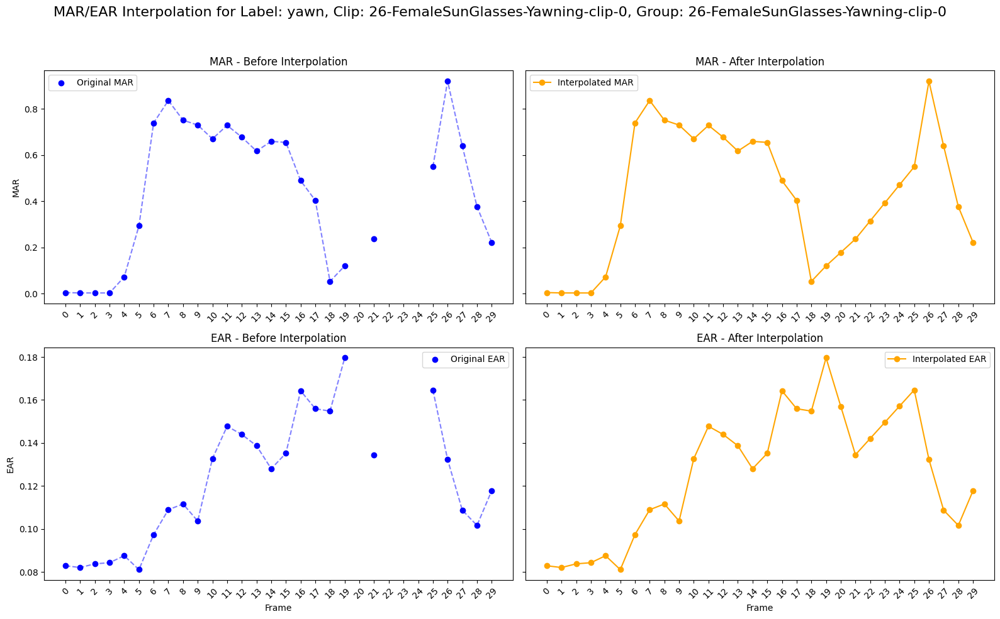

In [ ]:
# 예시 실행
label = "yawn"
clip_id = "26-FemaleSunGlasses-Yawning-clip-0"
group_id = clip_id
visualize_mar_ear_interpolation(yawn_text, label, clip_id, group_id, group_col='clip_id')

In [ ]:
def interpolate(df):
    # 데이터 정렬
    df = df.sort_values(by=['label', 'clip_id', 'frame_no']).reset_index(drop=True)

    def interpolate_group(group):
        return group.assign(
            MAR=lambda x: x['MAR'].interpolate(method='linear', limit_direction='both'),
            EAR=lambda x: x['EAR'].interpolate(method='linear', limit_direction='both')
        )

    # 3개 컬럼으로 그룹화하여 일괄 처리
    return df.groupby(['label', 'clip_id'], group_keys=False).apply(interpolate_group)

In [ ]:
yawn_text_interpolated = interpolate(yawn_text)
yawn_text_interpolated.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21303 entries, 0 to 21302
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   frame_path       21303 non-null  object 
 1   label            21303 non-null  object 
 2   camera           6153 non-null   object 
 3   clip_id          21303 non-null  object 
 4   frame_no         21303 non-null  int64  
 5   MAR              21303 non-null  float64
 6   MAR_horiz_dist   21288 non-null  float64
 7   MAR_vert_mean    21288 non-null  float64
 8   mouth_landmarks  21288 non-null  object 
 9   EAR              21303 non-null  float64
 10  EAR_horiz_dist   21288 non-null  float64
 11  EAR_vert_mean    21288 non-null  float64
 12  eyes_landmarks   21288 non-null  object 
dtypes: float64(6), int64(1), object(6)
memory usage: 2.3+ MB


<ipython-input-18-442e5464027d>:12: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  return df.groupby(['label', 'clip_id'], group_keys=False).apply(interpolate_group)


In [43]:
yawn_text_interpolated.to_csv("/content/drive/MyDrive/DMS/data/features/mar_ear_final/yawn_text_interpolated.csv", index=False)

In [ ]:
df_12f = pd.read_csv('/content/drive/MyDrive/DMS/data/EDA/mar_ear_final/final_df_12_mar_ear.csv')
df_12_interpolated = interpolate(df_12f)
df_12_interpolated

<ipython-input-99-f9e4390c9a50>:12: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  return df.groupby(['label', 'clip_id', 'groups_12'], group_keys=False).apply(interpolate_group)


,frame_path,label,camera,clip_id,frame_no,dataset,groups_12,MAR,MAR_horiz_dist,MAR_vert_mean,mouth_landmarks,EAR,EAR_horiz_dist,EAR_vert_mean,eyes_landmarks,is_mar_ear_streak5plus
0,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,0,yawDD,0,0.012913,0.077751,0.001004,"[[0.6879969835281372, 0.5694696307182312], [0....",0.161395,0.047641,0.014085,"[[0.7607617378234863, 0.4116917848587036], [0....",False
1,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,1,yawDD,0,0.020873,0.075224,0.001570,"[[0.6815370321273804, 0.5687231421470642], [0....",0.152588,0.048162,0.013940,"[[0.7577546834945679, 0.40831711888313293], [0...",False
2,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,2,yawDD,0,0.071455,0.081726,0.005840,"[[0.6768521666526794, 0.563867449760437], [0.6...",0.159343,0.047281,0.013904,"[[0.7555350065231323, 0.4042552411556244], [0....",False
3,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,3,yawDD,0,0.102460,0.072981,0.007478,"[[0.6829803586006165, 0.5668616890907288], [0....",0.162376,0.045473,0.013623,"[[0.7570106387138367, 0.4027590751647949], [0....",False
4,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-FemaleNoGlasses-Yawning-clip-1,4,yawDD,0,0.202449,0.069644,0.014099,"[[0.6937663555145264, 0.5600349307060242], [0....",0.164114,0.049113,0.015007,"[[0.7653884887695312, 0.4025568962097168], [0....",False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139987,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,31,DMD,2,0.054325,0.056845,0.003088,"[[0.44413378834724426, 0.6351353526115417], [0...",0.102960,0.033662,0.006922,"[[0.49295395612716675, 0.5448129773139954], [0...",False
139988,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,32,DMD,2,0.135679,0.052650,0.007144,"[[0.4613957405090332, 0.6372644305229187], [0....",0.104257,0.033511,0.006995,"[[0.5052523612976074, 0.5478636622428894], [0....",False
139989,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,33,DMD,2,0.103187,0.057156,0.005898,"[[0.46782296895980835, 0.6412728428840637], [0...",0.103494,0.035309,0.007308,"[[0.514333188533783, 0.5522364377975464], [0.5...",False
139990,/content/drive/MyDrive/DMS/data/DMD/dmd_frames...,yawn,NaN,face_2019-03-14-14;26;17_1_2.avi,34,DMD,2,0.238439,0.050842,0.012123,"[[0.4745681881904602, 0.6434462666511536], [0....",0.110059,0.033687,0.007423,"[[0.5239902138710022, 0.5539049506187439], [0....",False


In [ ]:
path = '/content/drive/MyDrive/DMS/data/EDA/mar_ear_final'
df_12_interpolated.to_csv(os.path.join(path, 'final_df_12_mar_ear_interpolated.csv'), index=False)

In [ ]:
df_24f = pd.read_csv('/content/drive/MyDrive/DMS/data/EDA/mar_ear_final/final_df_24_mar_ear.csv')

<ipython-input-103-3e9c395e3a49>:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_24f = pd.read_csv('/content/drive/MyDrive/DMS/data/EDA/mar_ear_final/final_df_24_mar_ear.csv')


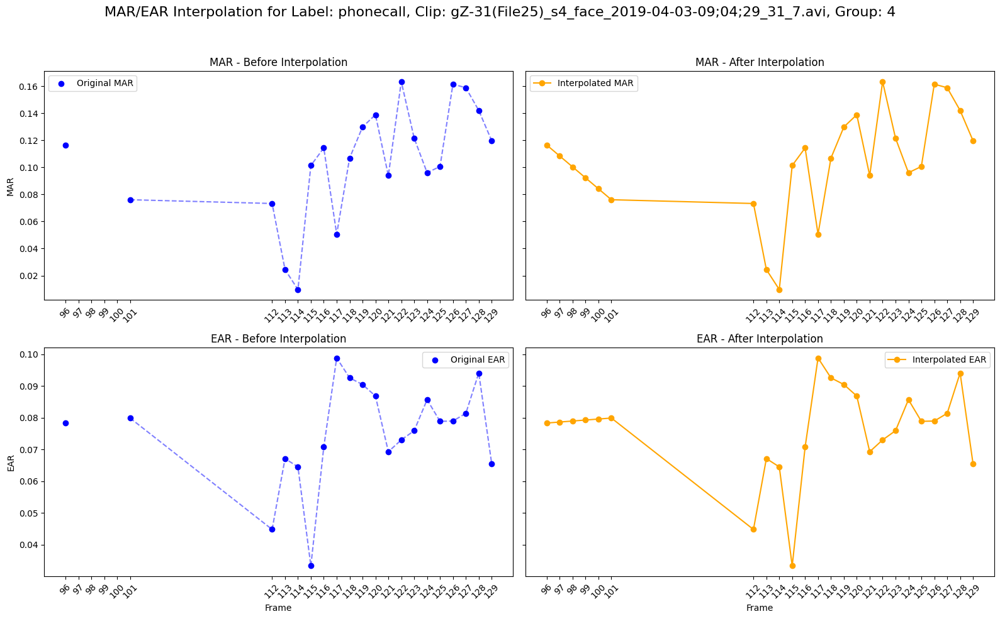

In [ ]:
label = "phonecall"
clip_id = "gZ-31(File25)_s4_face_2019-04-03-09;04;29_31_7.avi"
group_id = 4
visualize_mar_ear_interpolation(df_24f, label, clip_id, group_id, group_col='groups_24')

In [ ]:
def interpolate(df):
    # 데이터 정렬
    df = df.sort_values(by=['label', 'clip_id', 'groups_24', 'frame_no']).reset_index(drop=True)

    def interpolate_group(group):
        return group.assign(
            MAR=lambda x: x['MAR'].interpolate(method='linear', limit_direction='both'),
            EAR=lambda x: x['EAR'].interpolate(method='linear', limit_direction='both')
        )

    # 3개 컬럼으로 그룹화하여 일괄 처리
    return df.groupby(['label', 'clip_id', 'groups_24'], group_keys=False).apply(interpolate_group)

In [ ]:
df_24_interpolated = interpolate(df_24f)
df_24_interpolated.to_csv(os.path.join(path, 'final_df_24_mar_ear_interpolated.csv'), index=False)

<ipython-input-107-53ee4029ca85>:12: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  return df.groupby(['label', 'clip_id', 'groups_24'], group_keys=False).apply(interpolate_group)


📌 Group ID: 62, Clip: gE-27(File17)_s1_face_2019-03-07-13;14;28_27_0.avi


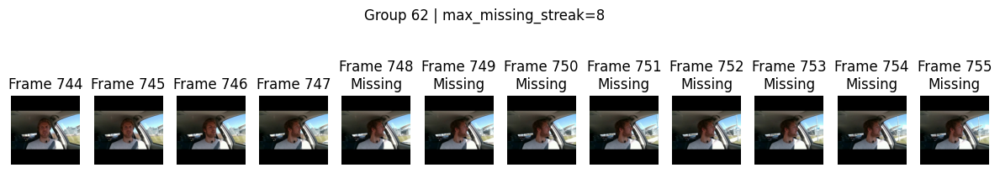

📌 Group ID: 63, Clip: gE-27(File17)_s1_face_2019-03-07-13;14;28_27_0.avi


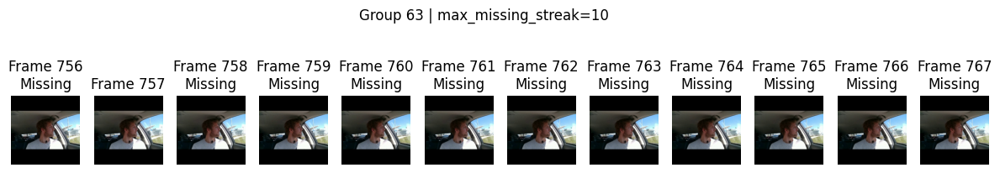

📌 Group ID: 64, Clip: gE-27(File17)_s1_face_2019-03-07-13;14;28_27_0.avi


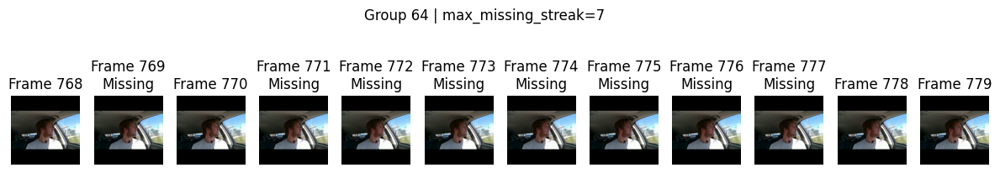

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# 프레임당 최대 몇 개까지만 출력
MAX_FRAMES_PER_GROUP = 12

# 해당 group의 프레임만
for group_id in severe_group_ids:
    group_data = severe_groups_df[severe_groups_df['groups_12'] == group_id]

    print(f"📌 Group ID: {group_id}, Clip: {group_data['clip_id'].iloc[0]}")

    # 프레임 순 정렬 및 최대 5개로 제한
    frame_subset = group_data.sort_values('frame_no').head(MAX_FRAMES_PER_GROUP)

    # 이미지 시각화
    plt.figure(figsize=(15, 3))
    for idx, row in enumerate(frame_subset.itertuples()):
        try:
            img = mpimg.imread(row.frame_path)
            plt.subplot(1, MAX_FRAMES_PER_GROUP, idx + 1)
            plt.imshow(img)
            # 제목에 'Missing' 조건부 표시
            title = f"Frame {row.frame_no}"
            if row.is_missing:
                title += "\nMissing"
            plt.title(title)

            plt.axis('off')
        except Exception as e:
            print(f"❌ 이미지 로드 실패: {row.frame_path} - {e}")

    plt.suptitle(f"Group {group_id} | max_missing_streak={group_streak_df[group_streak_df['group_id'] == group_id]['max_missing_streak'].values[0]}")
    plt.show()


In [ ]:
import cv2
import mediapipe as mp
from google.colab.patches import cv2_imshow


# MediaPipe Face Mesh 초기화
mp_face_mesh = mp.solutions.face_mesh
face_mesh = mp_face_mesh.FaceMesh(static_image_mode=True, max_num_faces=1, refine_landmarks=True)
mp_drawing = mp.solutions.drawing_utils

# 초록색 선을 위한 DrawingSpec 설정
GREEN_COLOR = (0, 255, 0)  # 초록색 (BGR)
DRAWING_SPEC = mp_drawing.DrawingSpec(color=GREEN_COLOR, thickness=1, circle_radius=1)

# 이미지 입력 및 처리
def draw_face_mesh(image_path, output_path=None, show_image=True):
    # 이미지 읽기
    image = cv2.imread(image_path)
    if image is None:
        print("이미지를 찾을 수 없습니다:", image_path)
        return

    # BGR → RGB 변환
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # 얼굴 랜드마크 감지
    results = face_mesh.process(rgb_image)

    if results.multi_face_landmarks:
        for face_landmarks in results.multi_face_landmarks:
            # 랜드마크 그리기 (초록색 적용)
            mp_drawing.draw_landmarks(
                image,
                face_landmarks,
                mp_face_mesh.FACEMESH_TESSELATION,  # 얼굴 삼각형 연결
                landmark_drawing_spec=DRAWING_SPEC,  # 점 스타일 (초록색)
                connection_drawing_spec=DRAWING_SPEC  # 선 스타일 (초록색)
            )


    # 결과 출력 또는 저장
    if output_path:
        cv2.imwrite(output_path, image)
        print(f"처리된 이미지가 저장되었습니다: {output_path}")

    if show_image:
        cv2_imshow(image)
        cv2.waitKey(0)
        cv2.destroyAllWindows()

처리된 이미지가 저장되었습니다: /content/drive/MyDrive/DMS/demo_data/bong_capture/mediapipe_output.jpg


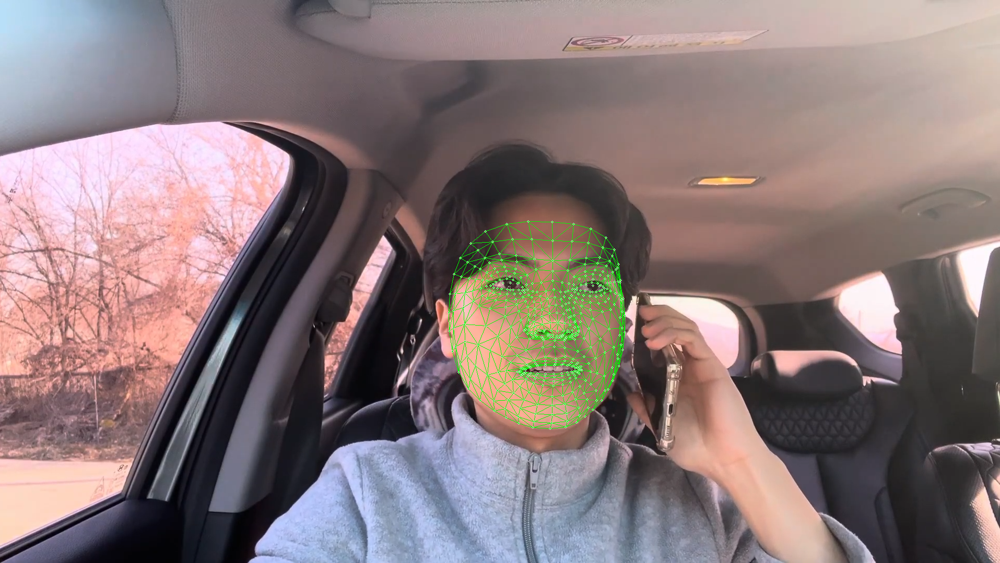

In [ ]:
# 테스트 실행
image_path = "/content/drive/MyDrive/DMS/demo_data/bong_capture/bong_capture.png"  # 입력 이미지 파일 경로
output_path = "/content/drive/MyDrive/DMS/demo_data/bong_capture/mediapipe_output.jpg"  # 저장할 이미지 파일 경로
draw_face_mesh(image_path, output_path)


In [ ]:
df = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results/mar_ear_train.csv")
df.head()

In [ ]:
df.head()

,file_path,label,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR,left_horizontal_dist,left_vertical_dist,right_horizontal_dist,right_vertical_dist,mouth_landmarks,eye_landmarks,video_clip,frame,video_name,dataset
0,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.376466,0.061949,0.023322,0.128341,0.148426,0.138383,0.040436,0.010379,0.035620,0.01057394940203409,"[(0.45304083824157715, 0.6389512419700623), (0...","[(0.49451518058776855, 0.5022357702255249), (0...",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000000.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD
1,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.243979,0.051054,0.012456,0.140002,0.114637,0.127319,0.031794,0.008902,0.042943,0.00984574098818084,"[(0.5035773515701294, 0.6430702805519104), (0....","[(0.5539824962615967, 0.5103051662445068), (0....",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000001.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD
2,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.304681,0.060706,0.018496,0.145839,0.135531,0.140685,0.040352,0.011770,0.044131,0.011962201728150868,"[(0.513645589351654, 0.6414036750793457), (0.5...","[(0.5763875246047974, 0.5118524432182312), (0....",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000002.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD
3,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.247592,0.066301,0.016416,0.158701,0.122808,0.140755,0.035250,0.011188,0.047811,0.011743132293623771,"[(0.532393217086792, 0.6401354670524597), (0.5...","[(0.6063141226768494, 0.5204540491104126), (0....",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000003.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD
4,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.047304,0.044065,0.002084,0.184732,0.133173,0.158952,0.027288,0.010082,0.040468,0.010778612528080657,"[(0.5485552549362183, 0.6214728951454163), (0....","[(0.5956661701202393, 0.5139091610908508), (0....",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000004.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD


In [ ]:
label = []
video_name = []
frame = []
dataset = []

for f in df['file_path']:
    print(f.split('/'))
    break
    video_name.append(f.split('/')[-2])
    frame.append(f.split('/')[-1])
    label.append(f.split('/')[-3].split('_')[0])
    dataset.append(f.split('/')[-3].split('_')[1])

df["label"] = label
df["video_name"] = video_name
df["frame"] = frame
df["dataset"] = dataset

['', 'content', 'drive', 'MyDrive', 'DMS', 'data', 'train_test_split_dataset', 'train_dataset', 'normal_DMD', 'gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_21.avi_part1', 'frame000000.jpg']


In [ ]:
label = []
video_name

### 테스트셋 전처리

In [ ]:
test_df = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results/mar_ear_test.csv")
test_df.head()

,file_path,label,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR,left_horizontal_dist,left_vertical_dist,right_horizontal_dist,right_vertical_dist,mouth_landmarks,eye_landmarks
0,tf.Tensor(b'/content/drive/MyDrive/DMS/data/tr...,"tf.Tensor(b'normal', shape=(), dtype=string)","tf.Tensor(0.3764660136666851, shape=(), dtype=...","tf.Tensor(0.06194884598763733, shape=(), dtype...","tf.Tensor(0.023321635100217245, shape=(), dtyp...","tf.Tensor(0.12834099193491608, shape=(), dtype...","tf.Tensor(0.14842558198608885, shape=(), dtype...","tf.Tensor(0.13838328696050245, shape=(), dtype...","tf.Tensor(0.04043624534916986, shape=(), dtype...","tf.Tensor(0.010379255676472193, shape=(), dtyp...","tf.Tensor(0.03562037372716898, shape=(), dtype...","tf.Tensor(0.01057394940203409, shape=(), dtype...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0..."
1,tf.Tensor(b'/content/drive/MyDrive/DMS/data/tr...,"tf.Tensor(b'normal', shape=(), dtype=string)","tf.Tensor(0.24397885476738854, shape=(), dtype...","tf.Tensor(0.051054431705454074, shape=(), dtyp...","tf.Tensor(0.012456201778296537, shape=(), dtyp...","tf.Tensor(0.1400016083454199, shape=(), dtype=...","tf.Tensor(0.11463716137515699, shape=(), dtype...","tf.Tensor(0.12731938486028843, shape=(), dtype...","tf.Tensor(0.03179399938978616, shape=(), dtype...","tf.Tensor(0.008902422100606721, shape=(), dtyp...","tf.Tensor(0.04294305995575057, shape=(), dtype...","tf.Tensor(0.00984574098818084, shape=(), dtype...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0..."
2,tf.Tensor(b'/content/drive/MyDrive/DMS/data/tr...,"tf.Tensor(b'normal', shape=(), dtype=string)","tf.Tensor(0.3046805418291058, shape=(), dtype=...","tf.Tensor(0.0607062600322996, shape=(), dtype=...","tf.Tensor(0.01849601619905963, shape=(), dtype...","tf.Tensor(0.14583874914106482, shape=(), dtype...","tf.Tensor(0.13553133604115558, shape=(), dtype...","tf.Tensor(0.1406850425911102, shape=(), dtype=...","tf.Tensor(0.04035164452162947, shape=(), dtype...","tf.Tensor(0.011769666725638684, shape=(), dtyp...","tf.Tensor(0.04413076000563594, shape=(), dtype...","tf.Tensor(0.011962201728150868, shape=(), dtyp...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0..."
3,tf.Tensor(b'/content/drive/MyDrive/DMS/data/tr...,"tf.Tensor(b'normal', shape=(), dtype=string)","tf.Tensor(0.24759245355978612, shape=(), dtype...","tf.Tensor(0.06630097557530597, shape=(), dtype...","tf.Tensor(0.016415621216097458, shape=(), dtyp...","tf.Tensor(0.15870140112883022, shape=(), dtype...","tf.Tensor(0.12280820659849094, shape=(), dtype...","tf.Tensor(0.14075480386366057, shape=(), dtype...","tf.Tensor(0.03524979591767567, shape=(), dtype...","tf.Tensor(0.011188384003280897, shape=(), dtyp...","tf.Tensor(0.04781086141912633, shape=(), dtype...","tf.Tensor(0.011743132293623771, shape=(), dtyp...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0..."
4,tf.Tensor(b'/content/drive/MyDrive/DMS/data/tr...,"tf.Tensor(b'normal', shape=(), dtype=string)","tf.Tensor(0.047303767249409136, shape=(), dtyp...","tf.Tensor(0.044064825528058994, shape=(), dtyp...","tf.Tensor(0.0020844322506651247, shape=(), dty...","tf.Tensor(0.1847320127791011, shape=(), dtype=...","tf.Tensor(0.1331729439321275, shape=(), dtype=...","tf.Tensor(0.1589524783556143, shape=(), dtype=...","tf.Tensor(0.02728794541099595, shape=(), dtype...","tf.Tensor(0.010081914160759034, shape=(), dtyp...","tf.Tensor(0.040468477341666524, shape=(), dtyp...","tf.Tensor(0.010778612528080657, shape=(), dtyp...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0...","[(<tf.Tensor: shape=(), dtype=float32, numpy=0..."


In [ ]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31068 entries, 0 to 31067
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   file_path              31068 non-null  object
 1   label                  30576 non-null  object
 2   MAR                    30576 non-null  object
 3   mouth_width            30576 non-null  object
 4   mouth_height           30576 non-null  object
 5   left_EAR               30576 non-null  object
 6   right_EAR              30576 non-null  object
 7   avg_EAR                30576 non-null  object
 8   left_horizontal_dist   30576 non-null  object
 9   left_vertical_dist     30576 non-null  object
 10  right_horizontal_dist  30576 non-null  object
 11  right_vertical_dist    31068 non-null  object
 12  mouth_landmarks        31068 non-null  object
 13  eye_landmarks          30452 non-null  object
dtypes: object(14)
memory usage: 3.3+ MB


In [ ]:
test_df.shape

(31068, 14)

In [ ]:
31068-7500

23568

In [ ]:
test_df[test_df['file_path']=="/content/drive/MyDrive/DMS/data/train_test_split_dataset/test_dataset/normal_DMD/gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.avi_part4/frame000036.jpg"].index

Index([7500], dtype='int64')

In [ ]:
test_df = test_df.iloc[7500:].reset_index(drop=True)

,file_path,label,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR,left_horizontal_dist,left_vertical_dist,right_horizontal_dist,right_vertical_dist,mouth_landmarks,eye_landmarks
0,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.03799125595552844,0.058221550672472415,0.0022119098337256685,0.1447587613979418,0.1436272161505942,0.144192988774268,0.04140253413519547,0.011986759120293804,0.04236065036381,0.012168284572165372,"[(0.4469671845436096, 0.7180995941162109), (0....","[(0.5017154216766357, 0.5785568952560425), (0...."
1,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.04286876462632554,0.060096543781512385,0.002576264590225322,0.14979126273270554,0.144542557448649,0.14716691009067728,0.041987892544257235,0.012578838887378888,0.04437863234976134,0.012829202031815702,"[(0.4483779966831207, 0.7193543910980225), (0....","[(0.5097396969795227, 0.5809462666511536), (0...."
2,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.04164143980183875,0.058847970164571155,0.0024505142070683924,0.12613940401469437,0.12892067882279346,0.1275300414187439,0.04161167508758085,0.010497743791201107,0.04337235124157128,0.011183185928407996,"[(0.4492361843585968, 0.7198998332023621), (0....","[(0.5107419490814209, 0.5833330154418945), (0...."
3,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.024705411983676383,0.05738753380358985,0.0014177826653448422,0.10396616712639484,0.09968483387917758,0.10182550050278621,0.038368933977637534,0.007978142004761346,0.04120768085158636,0.008215561640473107,"[(0.4510745406150818, 0.7180595993995667), (0....","[(0.5156036615371704, 0.5881567001342773), (0...."
4,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.03408077180825398,0.05228087463366733,0.0017817725583259504,0.14687295525763727,0.14366027215315055,0.1452666137053939,0.039279632074959235,0.011538231288563882,0.04229219393764494,0.012151416182071792,"[(0.4536834955215454, 0.718080461025238), (0.4...","[(0.5108946561813354, 0.5815122127532959), (0...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23563,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,0.3157657594370033,0.09880993764131696,0.031200794999233387,0.15427009312595255,0.10731983018953516,0.13079496165774385,0.05338045154028588,0.0164700144604506,0.08410176128809899,0.01805157348015921,"[(0.5699644684791565, 0.4372181296348572), (0....","[(0.6232001781463623, 0.1989552080631256), (0...."
23564,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,0.0317708821900415,0.10689640123032555,0.0033961929700280797,0.15039257474528875,0.10786423081617293,0.12912840278073084,0.05633697052076882,0.016945324099935707,0.08475584855840744,0.018284248823849315,"[(0.5624699592590332, 0.4468122720718384), (0....","[(0.6305323243141174, 0.20895424485206604), (0..."
23565,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,0.030392471580054134,0.10406007290254903,0.0031626428083090827,0.15775370076588094,0.10936873144501648,0.13356121610544872,0.054675071097649616,0.017250389610583765,0.08389338412743139,0.018350625997293302,"[(0.5623183846473694, 0.43609729409217834), (0...","[(0.6254308223724365, 0.20248718559741974), (0..."
23566,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,0.029476350065200725,0.10689718365492475,0.003150938806396615,0.15396301937281517,0.10886762348028133,0.13141532142654824,0.05558267142117564,0.01711535183362257,0.08428065720327232,0.018350869710153022,"[(0.5645121335983276, 0.44427376985549927), (0...","[(0.6327046751976013, 0.21399390697479248), (0..."


In [ ]:
test_df[test_df['right_vertical_dist']=='[]']

,file_path,label,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR,left_horizontal_dist,left_vertical_dist,right_horizontal_dist,right_vertical_dist,mouth_landmarks,eye_landmarks
571,/content/drive/MyDrive/DMS/data/train_test_spl...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN
572,/content/drive/MyDrive/DMS/data/train_test_spl...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN
573,/content/drive/MyDrive/DMS/data/train_test_spl...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN
996,/content/drive/MyDrive/DMS/data/train_test_spl...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN
997,/content/drive/MyDrive/DMS/data/train_test_spl...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23153,/content/drive/MyDrive/DMS/data/train_test_spl...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN
23154,/content/drive/MyDrive/DMS/data/train_test_spl...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN
23155,/content/drive/MyDrive/DMS/data/train_test_spl...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN
23156,/content/drive/MyDrive/DMS/data/train_test_spl...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN


In [ ]:
change_idx = test_df[test_df['right_vertical_dist']=='[]'].index
test_df.loc[change_idx, 'right_vertical_dist'] =np.nan
test_df.loc[change_idx, 'mouth_landmarks'] ='[]'

In [ ]:
# 변환할 컬럼 리스트
float_columns = ["MAR", "mouth_width", "mouth_height", "left_EAR", "right_EAR",
                 "avg_EAR", "left_horizontal_dist", "left_vertical_dist",
                 "right_horizontal_dist", "right_vertical_dist"]

# 여러 컬럼을 동시에 float 형으로 변환
test_df[float_columns] = test_df[float_columns].astype(float)

# 변환된 데이터 확인
print(test_df.dtypes)

file_path                 object
label                     object
MAR                      float64
mouth_width              float64
mouth_height             float64
left_EAR                 float64
right_EAR                float64
avg_EAR                  float64
left_horizontal_dist     float64
left_vertical_dist       float64
right_horizontal_dist    float64
right_vertical_dist      float64
mouth_landmarks           object
eye_landmarks             object
dtype: object


In [ ]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23568 entries, 0 to 23567
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   file_path              23568 non-null  object 
 1   label                  23076 non-null  object 
 2   MAR                    23076 non-null  float64
 3   mouth_width            23076 non-null  float64
 4   mouth_height           23076 non-null  float64
 5   left_EAR               23076 non-null  float64
 6   right_EAR              23076 non-null  float64
 7   avg_EAR                23076 non-null  float64
 8   left_horizontal_dist   23076 non-null  float64
 9   left_vertical_dist     23076 non-null  float64
 10  right_horizontal_dist  23076 non-null  float64
 11  right_vertical_dist    23076 non-null  float64
 12  mouth_landmarks        23568 non-null  object 
 13  eye_landmarks          23076 non-null  object 
dtypes: float64(10), object(4)
memory usage: 2.5+ MB


In [ ]:
23568-23076

492

In [ ]:
label = []
video_name = []
frame = []
dataset = []

for f in test_df['file_path']:
    video_name.append(f.split('/')[-2])
    frame.append(f.split('/')[-1])
    label.append(f.split('/')[-3].split('_')[0])
    dataset.append(f.split('/')[-3].split('_')[1])

test_df["label"] = label
test_df["video_name"] = video_name
test_df["frame"] = frame
test_df["dataset"] = dataset

In [ ]:
test_df

,file_path,label,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR,left_horizontal_dist,left_vertical_dist,right_horizontal_dist,right_vertical_dist,mouth_landmarks,eye_landmarks,video_name,frame,dataset
0,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.037991,0.058222,0.002212,0.144759,0.143627,0.144193,0.041403,0.011987,0.042361,0.012168,"[(0.4469671845436096, 0.7180995941162109), (0....","[(0.5017154216766357, 0.5785568952560425), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000036.jpg,DMD
1,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.042869,0.060097,0.002576,0.149791,0.144543,0.147167,0.041988,0.012579,0.044379,0.012829,"[(0.4483779966831207, 0.7193543910980225), (0....","[(0.5097396969795227, 0.5809462666511536), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000037.jpg,DMD
2,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.041641,0.058848,0.002451,0.126139,0.128921,0.127530,0.041612,0.010498,0.043372,0.011183,"[(0.4492361843585968, 0.7198998332023621), (0....","[(0.5107419490814209, 0.5833330154418945), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000038.jpg,DMD
3,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.024705,0.057388,0.001418,0.103966,0.099685,0.101826,0.038369,0.007978,0.041208,0.008216,"[(0.4510745406150818, 0.7180595993995667), (0....","[(0.5156036615371704, 0.5881567001342773), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000039.jpg,DMD
4,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.034081,0.052281,0.001782,0.146873,0.143660,0.145267,0.039280,0.011538,0.042292,0.012151,"[(0.4536834955215454, 0.718080461025238), (0.4...","[(0.5108946561813354, 0.5815122127532959), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000040.jpg,DMD
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23563,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,0.315766,0.098810,0.031201,0.154270,0.107320,0.130795,0.053380,0.016470,0.084102,0.018052,"[(0.5699644684791565, 0.4372181296348572), (0....","[(0.6232001781463623, 0.1989552080631256), (0....",mirror9-MaleNoGlasses-Yawning-clip-3_part3,frame000028.jpg,yawDD
23564,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,0.031771,0.106896,0.003396,0.150393,0.107864,0.129128,0.056337,0.016945,0.084756,0.018284,"[(0.5624699592590332, 0.4468122720718384), (0....","[(0.6305323243141174, 0.20895424485206604), (0...",mirror9-MaleNoGlasses-Yawning-clip-3_part3,frame000034.jpg,yawDD
23565,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,0.030392,0.104060,0.003163,0.157754,0.109369,0.133561,0.054675,0.017250,0.083893,0.018351,"[(0.5623183846473694, 0.43609729409217834), (0...","[(0.6254308223724365, 0.20248718559741974), (0...",mirror9-MaleNoGlasses-Yawning-clip-3_part3,frame000032.jpg,yawDD
23566,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,0.029476,0.106897,0.003151,0.153963,0.108868,0.131415,0.055583,0.017115,0.084281,0.018351,"[(0.5645121335983276, 0.44427376985549927), (0...","[(0.6327046751976013, 0.21399390697479248), (0...",mirror9-MaleNoGlasses-Yawning-clip-3_part3,frame000035.jpg,yawDD


In [ ]:
test_df.to_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results/mar_ear_test.csv", index=False)

In [ ]:
120-12-12

96

In [ ]:
97=108

# 재추출데이터 EDA

## 기본 탐색
- shape, null값, 데이터 분포

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results/mar_ear_results.csv")
df.head()

<ipython-input-4-dda478347803>:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results/mar_ear_results.csv")


,frame_path,label,camera,clip_id,frame_no,MAR,MAR_horiz_dist,MAR_vert_mean,mouth_landmarks,EAR,EAR_horiz_dist,EAR_vert_mean,eyes_landmarks
0,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,0,0.003843,0.092017,0.000354,"[[0.6790302395820618, 0.5664031505584717], [0....",0.120216,0.051741,0.012074,"[[0.7544835209846497, 0.4115215837955475], [0...."
1,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,1,0.004076,0.091086,0.000371,"[[0.6802352666854858, 0.5672312378883362], [0....",0.124289,0.050414,0.012138,"[[0.7565779685974121, 0.4120103120803833], [0...."
2,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,2,0.004031,0.093789,0.000378,"[[0.6815208196640015, 0.5677939653396606], [0....",0.116291,0.051359,0.011561,"[[0.757136881351471, 0.4125784635543823], [0.7..."
3,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,3,0.005841,0.091469,0.000534,"[[0.6822372674942017, 0.5668578147888184], [0....",0.130911,0.049372,0.012457,"[[0.7575653195381165, 0.4115835130214691], [0...."
4,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,4,0.032160,0.093394,0.003004,"[[0.6810718774795532, 0.5672640204429626], [0....",0.126964,0.051338,0.012637,"[[0.7571709156036377, 0.41263824701309204], [0..."


In [ ]:
df.shape

(145665, 13)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145665 entries, 0 to 145664
Data columns (total 13 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   frame_path       145665 non-null  object 
 1   label            145665 non-null  object 
 2   camera           10190 non-null   object 
 3   clip_id          145665 non-null  object 
 4   frame_no         145665 non-null  int64  
 5   MAR              145203 non-null  float64
 6   MAR_horiz_dist   145203 non-null  float64
 7   MAR_vert_mean    145203 non-null  float64
 8   mouth_landmarks  145203 non-null  object 
 9   EAR              145203 non-null  float64
 10  EAR_horiz_dist   145203 non-null  float64
 11  EAR_vert_mean    145203 non-null  float64
 12  eyes_landmarks   145203 non-null  object 
dtypes: float64(6), int64(1), object(6)
memory usage: 14.4+ MB


In [ ]:
df.isnull().sum()

,0
frame_path,0
label,0
camera,135475
clip_id,0
frame_no,0
MAR,462
MAR_horiz_dist,462
MAR_vert_mean,462
mouth_landmarks,462
EAR,462


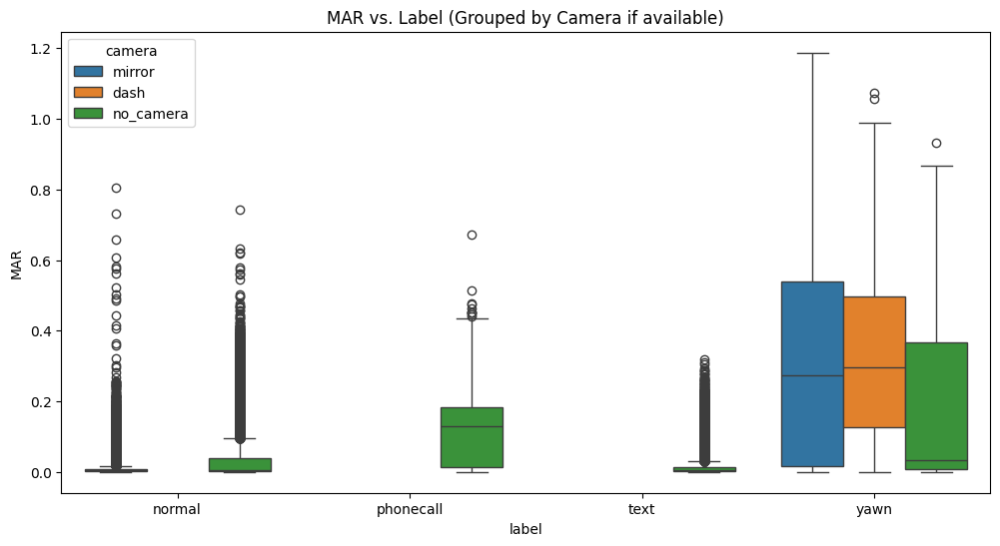

In [ ]:
df_plot = df.copy()
df_plot['camera'] = df_plot['camera'].fillna('no_camera')

label_order = ['normal', 'phonecall', 'text', 'yawn']

plt.figure(figsize=(12, 6))
sns.boxplot(x='label', y='MAR', hue='camera', data=df_plot, order=label_order)
plt.title('MAR vs. Label (Grouped by Camera if available)')
plt.show()


In [ ]:
dmd_yawn = df[(df['label'] == 'yawn') & (df['camera'].isna())]
print(dmd_yawn['MAR'].describe())

count    1324.000000
mean        0.188374
std         0.233643
min         0.000862
25%         0.008600
50%         0.033466
75%         0.366439
max         0.932903
Name: MAR, dtype: float64


<Axes: xlabel='camera', ylabel='MAR'>

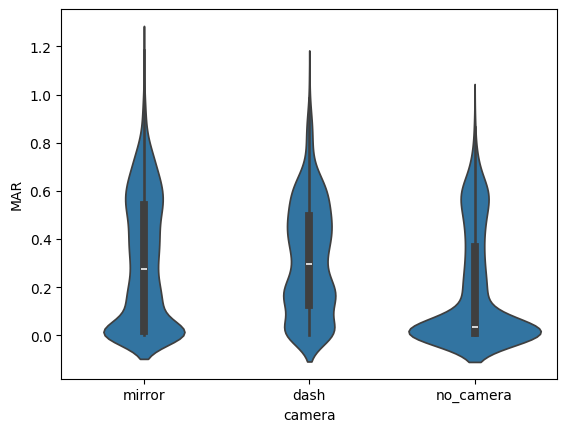

In [ ]:
yawn_all = df[df['label'] == 'yawn']
sns.violinplot(x='camera', y='MAR', data=yawn_all.fillna({'camera': 'no_camera'}))

<Axes: xlabel='label'>

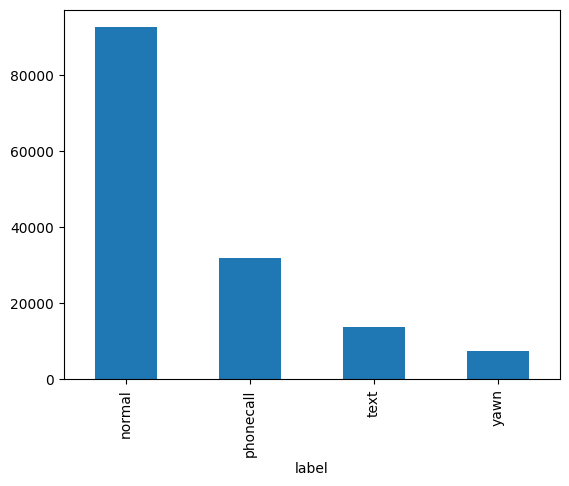

In [ ]:
df['label'].value_counts().plot(kind='bar')

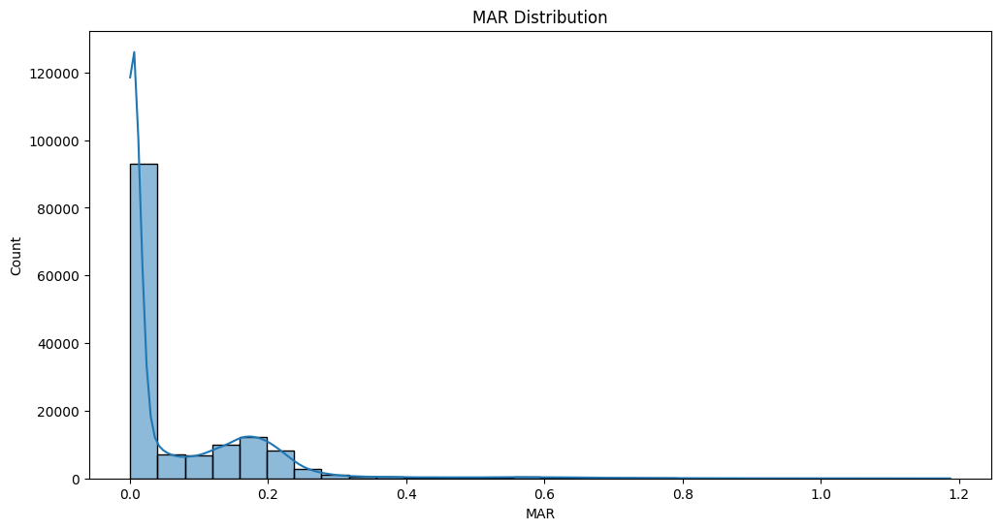

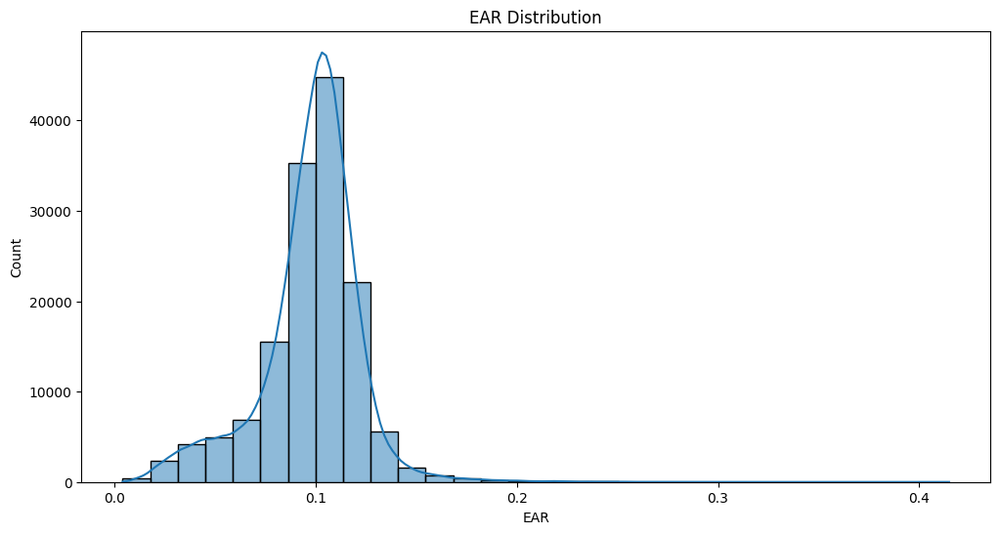

In [ ]:
plt.figure(figsize=(12, 6))
sns.histplot(df['MAR'], bins=30, kde=True)
plt.title('MAR Distribution')
plt.show()

plt.figure(figsize=(12, 6))
sns.histplot(df['EAR'], bins=30, kde=True)
plt.title('EAR Distribution')
plt.show()


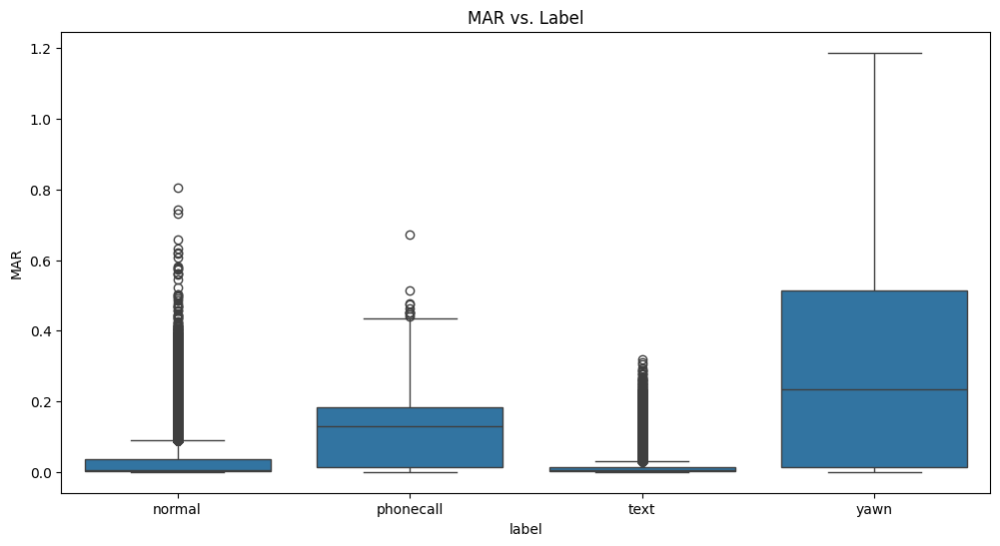

In [ ]:
label_order = ['normal', 'phonecall', 'text', 'yawn']

plt.figure(figsize=(12, 6))
sns.boxplot(x='label', y='MAR', data=df, order=label_order)
plt.title('MAR vs. Label')
plt.show()

In [ ]:
df.columns

Index(['frame_path', 'label', 'camera', 'clip_id', 'frame_no', 'MAR',
       'MAR_horiz_dist', 'MAR_vert_mean', 'mouth_landmarks', 'EAR',
       'EAR_horiz_dist', 'EAR_vert_mean', 'eyes_landmarks'],
      dtype='object')

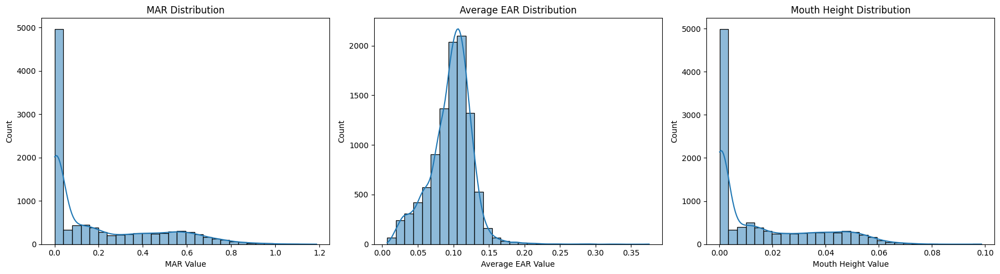

In [ ]:
df_clean = df.dropna()

# 주요 변수의 히스토그램 (분포 확인)
fig, axes = plt.subplots(1, 3, figsize=(18, 5))
sns.histplot(df_clean["MAR"], bins=30, kde=True, ax=axes[0], legend=df_clean["label"])
axes[0].set_title("MAR Distribution")
axes[0].set_xlabel("MAR Value")

sns.histplot(df_clean["EAR"], bins=30, kde=True, ax=axes[1], legend=df_clean["label"])
axes[1].set_title("Average EAR Distribution")
axes[1].set_xlabel("Average EAR Value")

sns.histplot(df_clean["MAR_vert_mean"], bins=30, kde=True, ax=axes[2], legend=df_clean["label"])
axes[2].set_title("Mouth Height Distribution")
axes[2].set_xlabel("Mouth Height Value")

plt.tight_layout()
plt.show()


In [ ]:
df_clean[["MAR", "mouth_width", "mouth_height", "left_EAR", "right_EAR", "avg_EAR"]].corr()

,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR
MAR,1.000000,0.219687,0.960148,-0.157740,-0.204133,-0.227374
mouth_width,0.219687,1.000000,0.403648,-0.187792,-0.394882,-0.366639
mouth_height,0.960148,0.403648,1.000000,-0.198312,-0.271054,-0.294965
left_EAR,-0.157740,-0.187792,-0.198312,1.000000,0.268533,0.793468
right_EAR,-0.204133,-0.394882,-0.271054,0.268533,1.000000,0.799330
avg_EAR,-0.227374,-0.366639,-0.294965,0.793468,0.799330,1.000000


- MAR (Mouth Aspect Ratio)와 MAR과 mouth_width의 상관계수는 0.219, mouth_height는 0.960으로 입이 벌어질 때 가로보다는 세로 길이가 더 큰 영향을 미친다.

In [ ]:
# 클래스별 평균값 확인
class_means = df.groupby("label")[["MAR", "mouth_width", "mouth_height", "left_EAR", "right_EAR", "avg_EAR"]].mean()
class_means

,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR
label,,,,,,
normal,0.086490,0.056547,0.004941,0.147448,0.141189,0.144318
phonecall,0.139583,0.057425,0.008301,0.144343,0.144626,0.144485
text,0.059787,0.053981,0.003195,0.145545,0.144808,0.145177
yawn,0.225499,0.083916,0.018695,0.137028,0.103063,0.120045


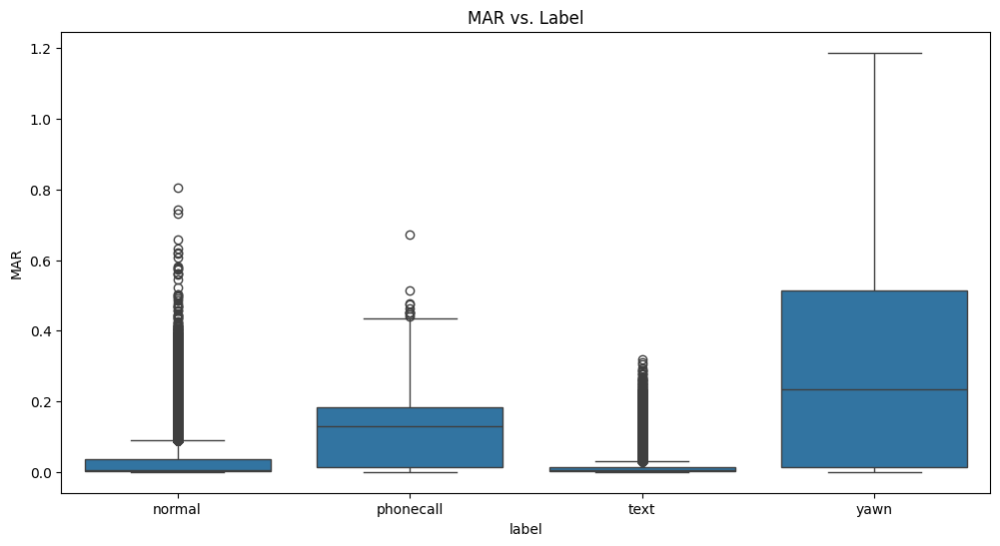

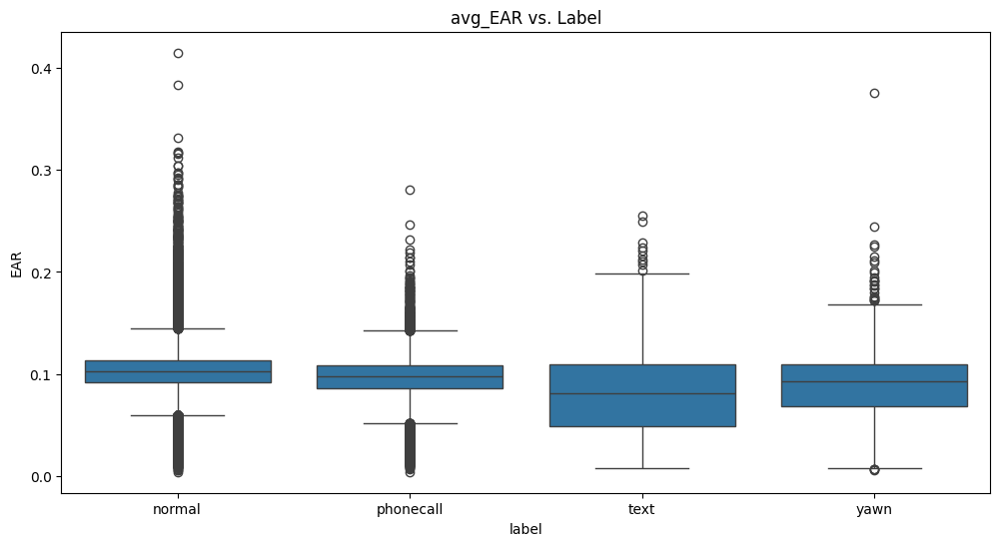

In [ ]:
plt.figure(figsize=(12, 6))
sns.boxplot(x="label", y="MAR", data=df, order=label_order)
plt.title("MAR vs. Label")
plt.show()

plt.figure(figsize=(12, 6))
sns.boxplot(x="label", y="EAR", data=df, order=label_order)
plt.title("avg_EAR vs. Label")
plt.show()

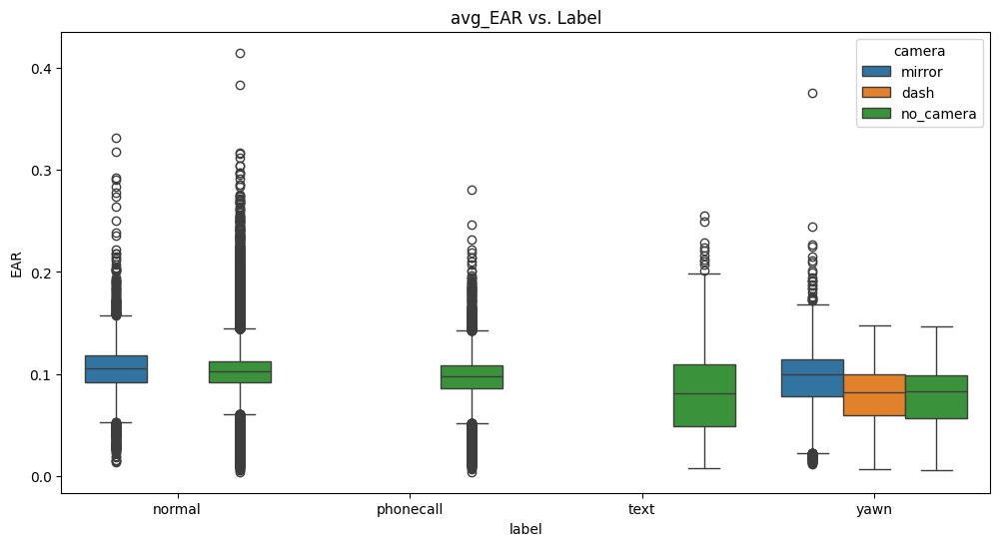

In [ ]:
plt.figure(figsize=(12, 6))
sns.boxplot(x="label", y="EAR", data=df, hue='camera', order=label_order)
plt.title("avg_EAR vs. Label")
plt.show()

<Axes: xlabel='camera', ylabel='EAR'>

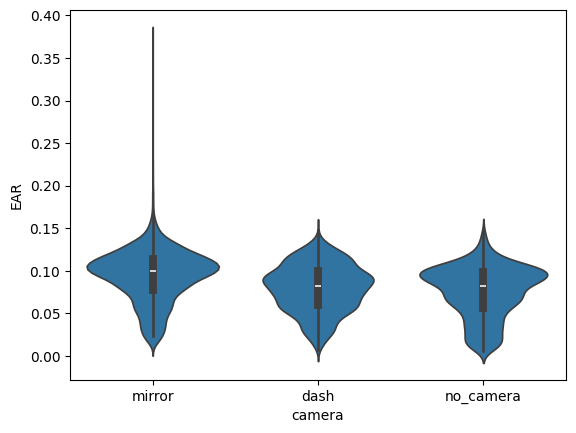

In [ ]:
yawn_all = df[df['label'] == 'yawn']
sns.violinplot(x='camera', y='EAR', data=yawn_all.fillna({'camera': 'no_camera'}))

## 시간에 따른 변동성

In [ ]:
df.columns

Index(['frame_path', 'label', 'camera', 'clip_id', 'frame_no', 'MAR',
       'MAR_horiz_dist', 'MAR_vert_mean', 'mouth_landmarks', 'EAR',
       'EAR_horiz_dist', 'EAR_vert_mean', 'eyes_landmarks'],
      dtype='object')

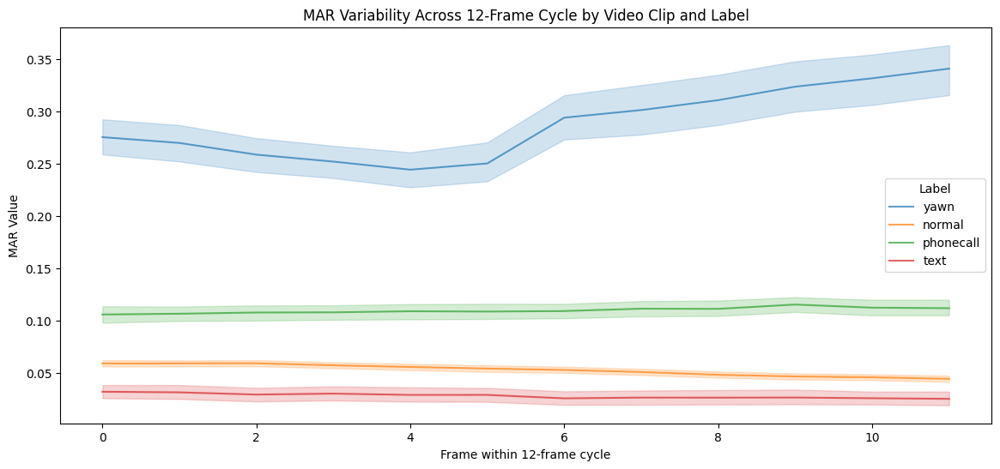

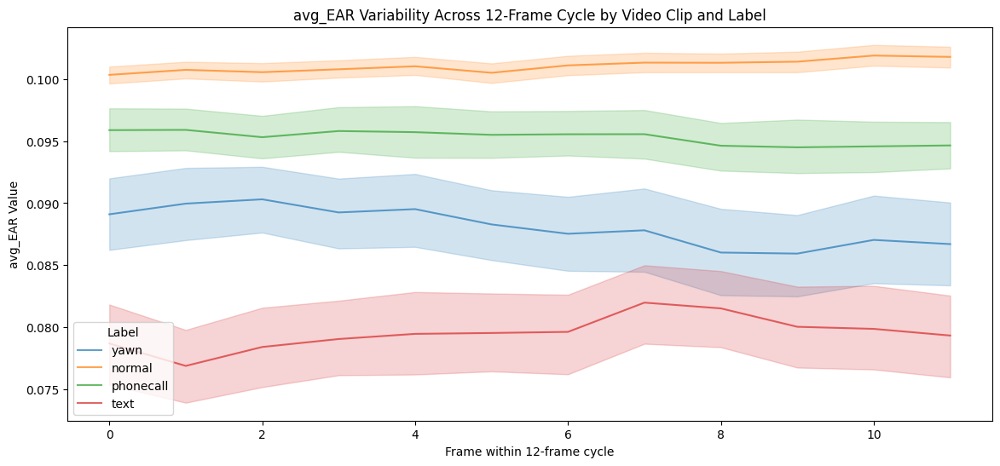

In [ ]:
import re

# 상위 디렉토리(비디오 클립 이름) 추출
# df["video_clip"] = df["file_path"].apply(lambda x: x.split("/")[-2])

# 프레임 번호 추출 (frame000000.jpg → 000000)
# df["frame_number"] = df["file_path"].apply(lambda x: int(re.search(r'frame(\d+)\.jpg', x).group(1)) if re.search(r'frame(\d+)\.jpg', x) else 0)

# 12프레임 단위로 프레임 인덱스 생성
df["frame_within_cycle"] = df["frame_no"] % 12  # 0~11까지의 프레임 번호 생성

# 비디오 클립별 프레임 내 평균값 계산
df_grouped = df.groupby(["clip_id", "frame_within_cycle", "label"])[["MAR", "EAR"]].mean().reset_index()

# 시각화: MAR 변동성
plt.figure(figsize=(14, 6))
sns.lineplot(data=df_grouped, x="frame_within_cycle", y="MAR", hue="label", alpha=0.7)
plt.xlabel("Frame within 12-frame cycle")
plt.ylabel("MAR Value")
plt.title("MAR Variability Across 12-Frame Cycle by Video Clip and Label")
plt.legend(title="Label")
plt.show()

# 시각화: avg_EAR 변동성
plt.figure(figsize=(14, 6))
sns.lineplot(data=df_grouped, x="frame_within_cycle", y="EAR", hue="label", alpha=0.7)
plt.xlabel("Frame within 12-frame cycle")
plt.ylabel("avg_EAR Value")
plt.title("avg_EAR Variability Across 12-Frame Cycle by Video Clip and Label")
plt.legend(title="Label")
plt.show()


In [ ]:
df_plot = df.copy()
df_plot['camera'] = df_plot['camera'].fillna('no_camera')

label_order = ['normal', 'phonecall', 'text', 'yawn']

plt.figure(figsize=(12, 6))
sns.boxplot(x='label', y='MAR', hue='camera', data=df_plot, order=label_order)
plt.title('MAR vs. Label (Grouped by Camera if available)')
plt.show()


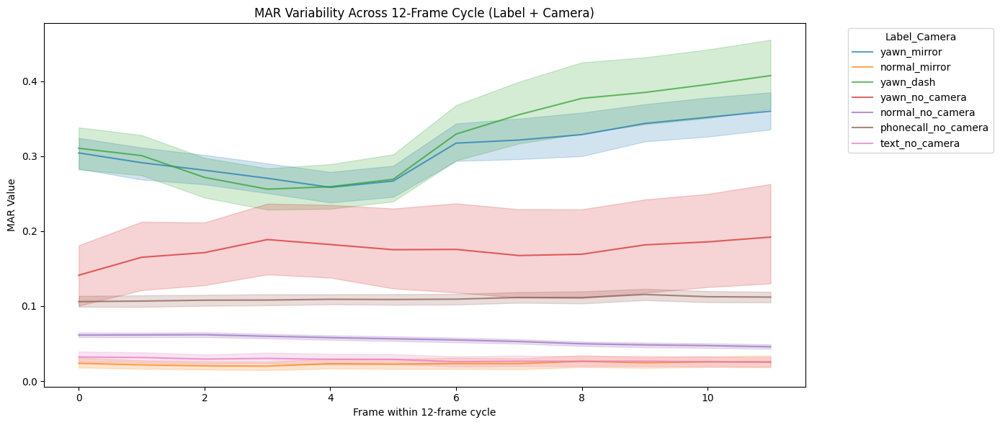

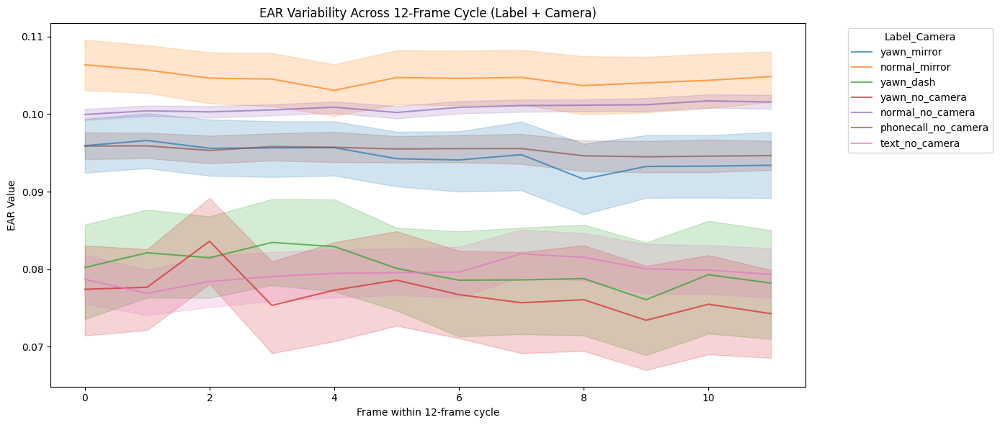

In [ ]:
# NaN camera → 'no_camera'로 채우기
df["camera"] = df["camera"].fillna("no_camera")

df["frame_within_cycle"] = df["frame_no"] % 12

# 클립 + 프레임 주기 + 라벨 + 카메라 별 그룹 평균
df_grouped = df.groupby(["clip_id", "frame_within_cycle", "label", "camera"])[["MAR", "EAR"]].mean().reset_index()


# Label과 camera 정보를 하나로 묶은 새로운 컬럼 생성
df_grouped["label_camera"] = df_grouped["label"] + "_" + df_grouped["camera"]

# MAR 시각화
plt.figure(figsize=(14, 6))
sns.lineplot(data=df_grouped, x="frame_within_cycle", y="MAR", hue="label_camera", alpha=0.7)
plt.xlabel("Frame within 12-frame cycle")
plt.ylabel("MAR Value")
plt.title("MAR Variability Across 12-Frame Cycle (Label + Camera)")
plt.legend(title="Label_Camera", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# EAR 시각화
plt.figure(figsize=(14, 6))
sns.lineplot(data=df_grouped, x="frame_within_cycle", y="EAR", hue="label_camera", alpha=0.7)
plt.xlabel("Frame within 12-frame cycle")
plt.ylabel("EAR Value")
plt.title("EAR Variability Across 12-Frame Cycle (Label + Camera)")
plt.legend(title="Label_Camera", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


### nan 최대개수

In [ ]:
import pandas as pd

# MAR 값이 NaN인지 여부 시리즈
is_nan = df['MAR'].isna()

# NaN 연속 구간 계산
max_nan_streak = (is_nan != is_nan.shift()).cumsum()
nan_streak_lengths = is_nan.groupby(max_nan_streak).sum()
longest_nan_streak = nan_streak_lengths.max()

print(f"MAR의 연속된 NaN 최대 길이: {longest_nan_streak} 프레임")


MAR의 연속된 NaN 최대 길이: 11 프레임


In [ ]:
df[df['clip_id'] == '1-FemaleNoGlasses-Yawning-clip-0']

,frame_path,label,camera,clip_id,frame_no,MAR,MAR_horiz_dist,MAR_vert_mean,mouth_landmarks,EAR,EAR_horiz_dist,EAR_vert_mean,eyes_landmarks,frame_within_cycle
0,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,0,0.003843,0.092017,0.000354,"[[0.6790302395820618, 0.5664031505584717], [0....",0.120216,0.051741,0.012074,"[[0.7544835209846497, 0.4115215837955475], [0....",0
1,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,1,0.004076,0.091086,0.000371,"[[0.6802352666854858, 0.5672312378883362], [0....",0.124289,0.050414,0.012138,"[[0.7565779685974121, 0.4120103120803833], [0....",1
2,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,2,0.004031,0.093789,0.000378,"[[0.6815208196640015, 0.5677939653396606], [0....",0.116291,0.051359,0.011561,"[[0.757136881351471, 0.4125784635543823], [0.7...",2
3,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,3,0.005841,0.091469,0.000534,"[[0.6822372674942017, 0.5668578147888184], [0....",0.130911,0.049372,0.012457,"[[0.7575653195381165, 0.4115835130214691], [0....",3
4,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,4,0.032160,0.093394,0.003004,"[[0.6810718774795532, 0.5672640204429626], [0....",0.126964,0.051338,0.012637,"[[0.7571709156036377, 0.41263824701309204], [0...",4
5,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,5,0.017778,0.091749,0.001631,"[[0.6799357533454895, 0.5681599378585815], [0....",0.116833,0.051123,0.011611,"[[0.756234884262085, 0.41279345750808716], [0....",5
6,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,6,0.019189,0.093606,0.001796,"[[0.6801313757896423, 0.5682053565979004], [0....",0.064311,0.051744,0.006379,"[[0.7575814127922058, 0.41336798667907715], [0...",6
7,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,7,0.002721,0.090765,0.000247,"[[0.6811327934265137, 0.5678466558456421], [0....",0.109570,0.052751,0.011300,"[[0.7578123211860657, 0.41166141629219055], [0...",7
8,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,8,0.002349,0.089995,0.000211,"[[0.687282145023346, 0.5640760064125061], [0.6...",0.134145,0.049919,0.012668,"[[0.7625452876091003, 0.4081791341304779], [0....",8
9,/content/drive/MyDrive/DMS/data/YawDD dataset/...,yawn,mirror,1-FemaleNoGlasses-Yawning-clip-0,9,0.196940,0.081361,0.016023,"[[0.6927784085273743, 0.5610550045967102], [0....",0.140730,0.049502,0.012966,"[[0.7692371606826782, 0.4049857556819916], [0....",9


In [ ]:
from collections import defaultdict

def get_max_nan_streak_per_clip(df):
    result = {}

    for clip_id, group in df.groupby(['clip_id']):
        is_nan = group['MAR'].isna().reset_index(drop=True)
        nan_group = (is_nan != is_nan.shift()).cumsum()
        streak_lengths = is_nan.groupby(nan_group).sum()
        max_streak = streak_lengths.max() if not streak_lengths.empty else 0
        result[clip_id] = max_streak

    return pd.Series(result, name='max_nan_streak').sort_values(ascending=False)

max_nan_streak_per_clip = get_max_nan_streak_per_clip(df)
print(max_nan_streak_per_clip.head())


gZ-33(File27)_s2_face_2019-04-08-09;59;25_33_20.avi    11
gZ-31(File25)_s4_face_2019-04-03-09;04;29_31_7.avi     10
gE-27(File17)_s1_face_2019-03-07-13;14;28_27_0.avi     10
gZ-34(File28)_s3_face_2019-04-04-15;33;18_34_1.avi      8
gE-30(File20)_s1_face_2019-03-15-10;58;06_30_26.avi     8
Name: max_nan_streak, dtype: int64


In [ ]:
max_nan_streak_per_clip = max_nan_streak_per_clip.reset_index()

In [ ]:
max_nan_streak_per_clip.groupby('max_nan_streak')['index'].count()

,index
max_nan_streak,
0,2614
1,64
2,20
3,14
4,11
5,8
6,4
7,1
8,2


##

<ipython-input-34-ba14c318e0a9>:8: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("label").apply(lambda x: x.sample(n=min(100, len(x)), random_state=42)).reset_index(drop=True)


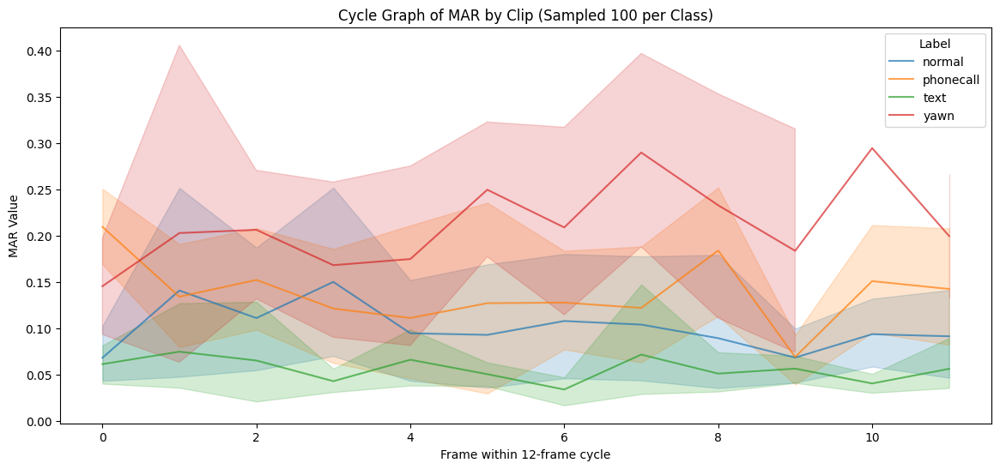

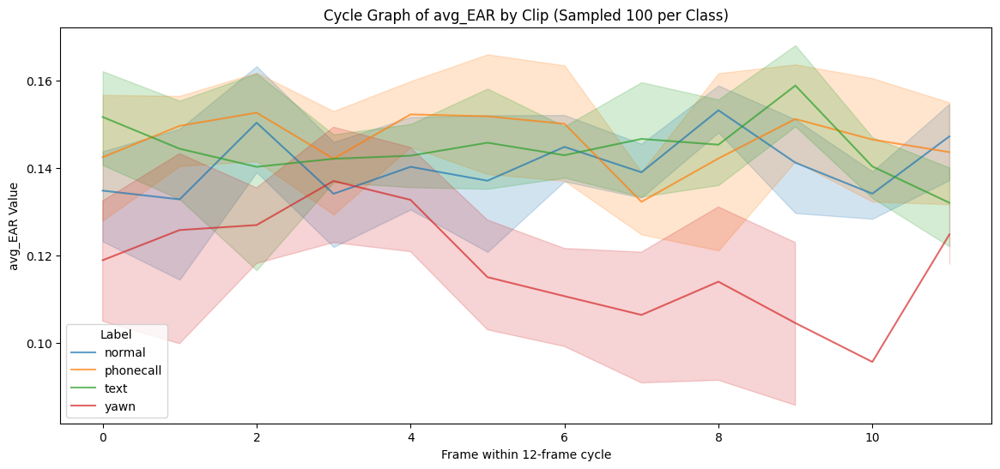

In [ ]:
import re

# 2. Clip 별로 Cycle Graph (랜덤 샘플링 100개)
df["video_clip"] = df["file_path"].apply(lambda x: x.split("/")[-2])  # Clip 단위로 그룹화
df["frame_within_cycle"] = df["file_path"].apply(lambda x: int(re.search(r'frame(\d+)\.jpg', x).group(1)) % 12 if re.search(r'frame(\d+)\.jpg', x) else 0)

# 각 클래스별 100개 샘플링
sampled_df = df.groupby("label").apply(lambda x: x.sample(n=min(100, len(x)), random_state=42)).reset_index(drop=True)

plt.figure(figsize=(14, 6))
sns.lineplot(data=sampled_df, x="frame_within_cycle", y="MAR", hue="label", alpha=0.7)
plt.xlabel("Frame within 12-frame cycle")
plt.ylabel("MAR Value")
plt.title("Cycle Graph of MAR by Clip (Sampled 100 per Class)")
plt.legend(title="Label")
plt.show()

plt.figure(figsize=(14, 6))
sns.lineplot(data=sampled_df, x="frame_within_cycle", y="avg_EAR", hue="label", alpha=0.7)
plt.xlabel("Frame within 12-frame cycle")
plt.ylabel("avg_EAR Value")
plt.title("Cycle Graph of avg_EAR by Clip (Sampled 100 per Class)")
plt.legend(title="Label")
plt.show()

## 랜드마크 미추출 이미지 확인

In [ ]:
df.columns

Index(['frame_path', 'label', 'camera', 'clip_id', 'frame_no', 'MAR',
       'MAR_horiz_dist', 'MAR_vert_mean', 'mouth_landmarks', 'EAR',
       'EAR_horiz_dist', 'EAR_vert_mean', 'eyes_landmarks',
       'frame_within_cycle'],
      dtype='object')

In [ ]:
# 랜드마크 추출 못한 데이터 찾기 (결측값이 있는 경우로 판단)
missing_landmarks = df[df["mouth_landmarks"].isna() | df["eyes_landmarks"].isna()]

missing_label = []
for f in missing_landmarks['frame_path']:
    missing_label.append(f.split('/')[-3])
missing_landmarks["label"] = missing_label

# 라벨별 결측 데이터 개수 확인
missing_counts = missing_landmarks["label"].value_counts()

# 결과 출력
display(missing_counts)

# 랜드마크가 없는 이미지 파일 경로 리스트
missing_images = missing_landmarks["frame_path"].tolist()

<ipython-input-26-19c70d49c016>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  missing_landmarks["label"] = missing_label


,count
label,
Normal,391
PhoneCall,56
Text,10
yawn_mirror,4
yawn,1


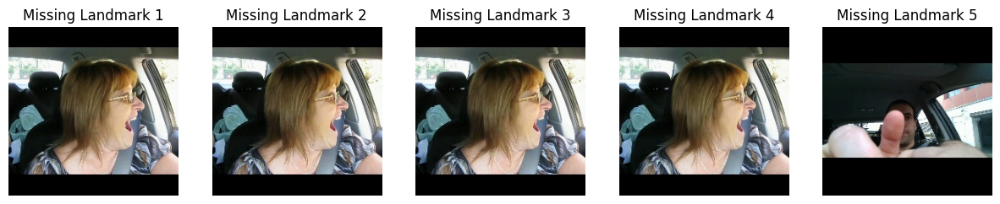

In [ ]:
fig, axes = plt.subplots(1, min(5, len(missing_images)), figsize=(15, 5))

for i, img_path in enumerate(missing_images[:5]):  # 최대 5개 이미지 출력
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) if img is not None else np.zeros((100, 100, 3), dtype=np.uint8)
    axes[i].imshow(img)
    axes[i].axis("off")
    axes[i].set_title(f"Missing Landmark {i+1}")

plt.show()


## group_id

In [ ]:
# landmark 추출 실패 여부 (None이면 1, 아니면 0)
df['landmark_fail'] = df['mouth_landmarks'].isnull().astype(int)

# 12프레임씩 그룹핑을 위한 시퀀스 번호 생성
total_df = df.sort_values(['clip_id', 'frame_no']).reset_index(drop=True)

# group 번호 부여
total_df['seq_group'] = (
    total_df.groupby('clip_id').cumcount() // 12
)

# 고유 그룹 식별을 위해 clip_id + group 번호 조합
total_df['group_id'] = total_df['clip_id'] + '_g' + total_df['seq_group'].astype(str)

# 각 group_id에서 가장 많이 나타난 label을 대표 label로 사용
group_summary = (
    total_df.groupby('group_id')
    .agg(
        fail_count=('landmark_fail', 'sum'),
        total_count=('landmark_fail', 'count'),
        label=('label', lambda x: x.mode().iloc[0])  # 다수 라벨 사용
    )
    .assign(fail_rate=lambda x: x['fail_count'] / x['total_count'])
    .reset_index()
)


In [ ]:
group_summary

,group_id,fail_count,total_count,label,fail_rate
0,1-FemaleNoGlasses-Yawning-clip-0_g0,0,12,yawn,0.0
1,1-FemaleNoGlasses-Yawning-clip-0_g1,0,12,yawn,0.0
2,1-FemaleNoGlasses-Yawning-clip-0_g2,0,12,yawn,0.0
3,1-FemaleNoGlasses-Yawning-clip-0_g3,0,6,yawn,0.0
4,1-FemaleNoGlasses-Yawning-clip-1_g0,0,12,normal,0.0
...,...,...,...,...,...
13352,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,0,12,normal,0.0
13353,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,0,12,normal,0.0
13354,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,0,12,normal,0.0
13355,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,0,12,normal,0.0


In [ ]:
plt.figure(figsize=(8, 5))
sns.boxplot(x='label', y='fail_rate', data=group_summary, order=label_order)
plt.title("시퀀스 단위 랜드마크 추출 실패율 (Label별)")
plt.ylabel("Failure Rate")
plt.xlabel("Label")
plt.ylim(0, 1)
plt.tight_layout()
plt.show()

ValueError: Could not interpret value `fail_rate` for `y`. An entry with this name does not appear in `data`.

<Figure size 800x500 with 0 Axes>

In [ ]:
group_summary = (
    total_df.groupby('group_id')
    .agg(
        fail_count=('landmark_fail', 'sum'),
        label=('label', lambda x: x.mode().iloc[0])  # 대표 label
    )
    .reset_index()
)

In [ ]:
group_summary

,group_id,fail_count,label
0,1-FemaleNoGlasses-Yawning-clip-0_g0,0,yawn
1,1-FemaleNoGlasses-Yawning-clip-0_g1,0,yawn
2,1-FemaleNoGlasses-Yawning-clip-0_g2,0,yawn
3,1-FemaleNoGlasses-Yawning-clip-0_g3,0,yawn
4,1-FemaleNoGlasses-Yawning-clip-1_g0,0,normal
...,...,...,...
13352,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,0,normal
13353,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,0,normal
13354,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,0,normal
13355,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,0,normal


In [ ]:
group_summary[group_summary['fail_count']>0].groupby(['label','fail_count' ])['label'].count()

label      fail_count
normal     1             79
           2             39
           3             26
           4             12
           5              8
           6              6
           7              2
           8              2
           11             2
phonecall  1             10
           2              1
           3              2
           6              1
           7              1
           8              1
text       1              2
           2              1
           3              1
yawn       1              2
           3              1
Name: label, dtype: int64

<ipython-input-57-f200370d12a5>:23: UserWarning: Glyph 49884 (\N{HANGUL SYLLABLE SI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-57-f200370d12a5>:23: UserWarning: Glyph 53248 (\N{HANGUL SYLLABLE KWEON}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-57-f200370d12a5>:23: UserWarning: Glyph 49828 (\N{HANGUL SYLLABLE SEU}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-57-f200370d12a5>:23: UserWarning: Glyph 44060 (\N{HANGUL SYLLABLE GAE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-57-f200370d12a5>:23: UserWarning: Glyph 49688 (\N{HANGUL SYLLABLE SU}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-57-f200370d12a5>:23: UserWarning: Glyph 48324 (\N{HANGUL SYLLABLE BYEOL}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-57-f200370d12a5>:23: UserWarning: Glyph 49892 (\N{HANGUL SYLLABLE SIL}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipy

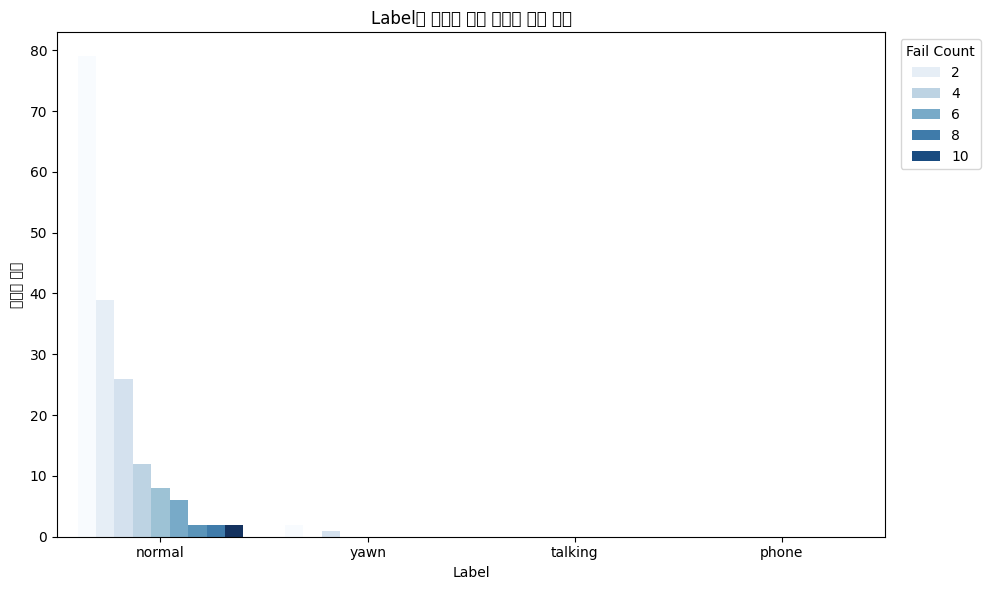

In [ ]:
# label + fail_count 조합으로 시퀀스 개수 집계
fail_count_by_label = (
    group_summary[group_summary['fail_count'] > 0]
    .groupby(['label', 'fail_count'])['label']
    .count()
    .reset_index(name='count')  # groupby 결과를 DataFrame으로 변환
)
plt.figure(figsize=(10, 6))

sns.barplot(
    data=fail_count_by_label,
    x='label',
    y='count',
    hue='fail_count',       # 실패 프레임 개수에 따라 색 구분
    palette='Blues',
    order=['normal', 'yawn', 'talking', 'phone']  # x축 순서 고정
)

plt.title("Label별 시퀀스 실패 프레임 개수 분포")
plt.xlabel("Label")
plt.ylabel("시퀀스 개수")
plt.legend(title="Fail Count", bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()
plt.show()


<ipython-input-55-ff9e572ad851>:10: UserWarning: Glyph 49892 (\N{HANGUL SYLLABLE SIL}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-55-ff9e572ad851>:10: UserWarning: Glyph 54056 (\N{HANGUL SYLLABLE PAE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-55-ff9e572ad851>:10: UserWarning: Glyph 54532 (\N{HANGUL SYLLABLE PEU}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-55-ff9e572ad851>:10: UserWarning: Glyph 47112 (\N{HANGUL SYLLABLE RE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-55-ff9e572ad851>:10: UserWarning: Glyph 51076 (\N{HANGUL SYLLABLE IM}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-55-ff9e572ad851>:10: UserWarning: Glyph 44060 (\N{HANGUL SYLLABLE GAE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-55-ff9e572ad851>:10: UserWarning: Glyph 49688 (\N{HANGUL SYLLABLE SU}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-

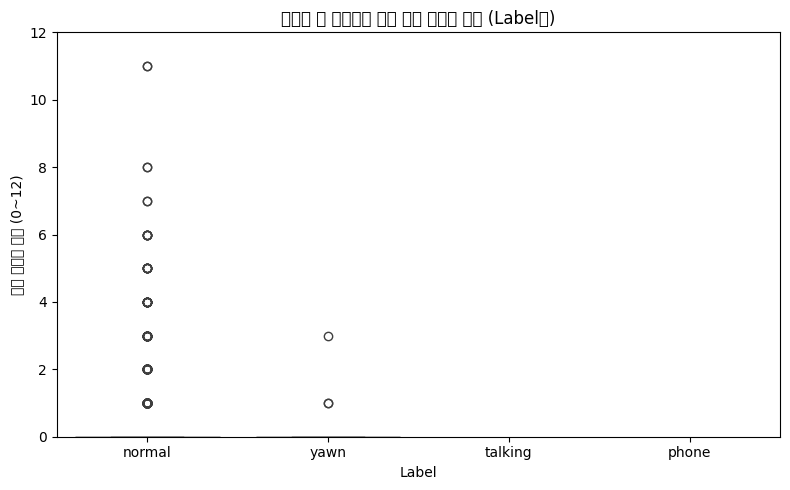

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
sns.boxplot(x='label', y='fail_count', data=group_summary, order=['normal', 'yawn', 'talking', 'phone'])
plt.title("시퀀스 내 랜드마크 추출 실패 프레임 개수 (Label별)")
plt.ylabel("실패 프레임 개수 (0~12)")
plt.xlabel("Label")
plt.ylim(0, 12)
plt.tight_layout()
plt.show()


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))

sns.barplot(
    data=fail_count_by_label,
    x='label',
    y='count',
    hue='fail_count',       # 실패 프레임 개수에 따라 색 구분
    palette='Blues',
    order=['normal', 'yawn', 'talking', 'phone']  # x축 순서 고정
)

plt.title("Label별 시퀀스 실패 프레임 개수 분포")
plt.xlabel("Label")
plt.ylabel("시퀀스 개수")
plt.legend(title="Fail Count", bbox_to_anchor=(1.01, 1), loc='upper left')
plt.tight_layout()
plt.show()
# video_clip 컬럼 생성 (상위 디렉토리 추출)
df["clip_id"] = df["frame_path"].apply(lambda x: x.split("/")[-2])

# 랜드마크가 NaN이 아닌 개수 계산
landmark_counts_by_folder = (
    df.groupby(["clip_id", "label"])[["mouth_landmarks", "eyes_landmarks"]]
    .apply(lambda x: x.notna().sum())
    .reset_index()
)

landmark_counts_by_folder

,clip_id,label,mouth_landmarks,eyes_landmarks
0,1-FemaleNoGlasses-Yawning-clip-0,yawn,42,42
1,1-FemaleNoGlasses-Yawning-clip-1,normal,32,32
2,1-FemaleNoGlasses-clip-0,yawn,48,48
3,1-FemaleNoGlasses-clip-1,yawn,48,48
4,1-MaleGlasses-clip-0,yawn,36,36
...,...,...,...,...
3149,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_5...,normal,64,64
3150,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_6...,normal,28,28
3151,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_7...,normal,69,69
3152,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_8...,normal,41,41


In [ ]:
landmark_counts_by_folder[landmark_counts_by_folder['MAR']<6].reset_index().to_excel("/content/drive/MyDrive/DMS/data/EDA/mar_results/nan_landmark_over6.xlsx")

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104940 entries, 0 to 104939
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   file_path              104940 non-null  object 
 1   label                  101253 non-null  object 
 2   MAR                    101253 non-null  float64
 3   mouth_width            101253 non-null  float64
 4   mouth_height           101253 non-null  float64
 5   left_EAR               101253 non-null  float64
 6   right_EAR              101253 non-null  float64
 7   avg_EAR                101253 non-null  float64
 8   left_horizontal_dist   101253 non-null  float64
 9   left_vertical_dist     101253 non-null  float64
 10  right_horizontal_dist  101253 non-null  float64
 11  right_vertical_dist    104940 non-null  object 
 12  mouth_landmarks        104940 non-null  object 
 13  eye_landmarks          101253 non-null  object 
 14  video_clip             104940 non-nu

In [ ]:
df['MAR'].isnull().sum()

3687

In [ ]:
# 각 폴더 내에서 랜드마크가 추출된 개수 확인
# df["video_clip"] = df["file_path"].apply(lambda x: x.split("/")[-2])  # 상위 디렉토리 추출
landmark_counts_by_folder = df.groupby(["video_clip", "label"]).apply(lambda x: x[["MAR"]].notna().sum())
landmark_counts_by_folder

<ipython-input-28-a950f10a63ce>:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  landmark_counts_by_folder = df.groupby(["video_clip", "label"]).apply(lambda x: x[["MAR"]].notna().sum())


,,MAR
video_clip,label,
dash1-FemaleNoGlasses-clip-0_part1,yawn,12
dash1-FemaleNoGlasses-clip-0_part2,yawn,12
dash1-FemaleNoGlasses-clip-0_part3,yawn,12
dash1-FemaleNoGlasses-clip-0_part4,yawn,12
dash1-FemaleNoGlasses-clip-1_part1,yawn,12
...,...,...
mirror47-MaleNoGlasses-Yawning-clip-0_part3,normal,12
mirror47-MaleNoGlasses-Yawning-clip-1_part1,yawn,12
mirror47-MaleNoGlasses-Yawning-clip-1_part2,yawn,12


In [ ]:
landmark_counts_by_folder = total_df.groupby(["group_id", "label"]).apply(lambda x: x[["MAR"]].notna().sum())
landmark_counts_by_folder

<ipython-input-59-3fed5fe90caa>:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  landmark_counts_by_folder = total_df.groupby(["group_id", "label"]).apply(lambda x: x[["MAR"]].notna().sum())


,,MAR
group_id,label,
1-FemaleNoGlasses-Yawning-clip-0_g0,yawn,12
1-FemaleNoGlasses-Yawning-clip-0_g1,yawn,12
1-FemaleNoGlasses-Yawning-clip-0_g2,yawn,12
1-FemaleNoGlasses-Yawning-clip-0_g3,yawn,6
1-FemaleNoGlasses-Yawning-clip-1_g0,normal,12
...,...,...
gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9.avi_g5,normal,12
gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9.avi_g6,normal,12
gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9.avi_g7,normal,12


In [ ]:
landmark_counts_by_folder.reset_index(inplace=True)
landmark_counts_by_folder.columns = ["video_clip", "label", "count"]
landmark_counts_by_folder

,video_clip,label,count
0,1-FemaleNoGlasses-Yawning-clip-0_g0,yawn,12
1,1-FemaleNoGlasses-Yawning-clip-0_g1,yawn,12
2,1-FemaleNoGlasses-Yawning-clip-0_g2,yawn,12
3,1-FemaleNoGlasses-Yawning-clip-0_g3,yawn,6
4,1-FemaleNoGlasses-Yawning-clip-1_g0,normal,12
...,...,...,...
17803,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,normal,12
17804,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,normal,12
17805,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,normal,12
17806,gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9...,normal,12


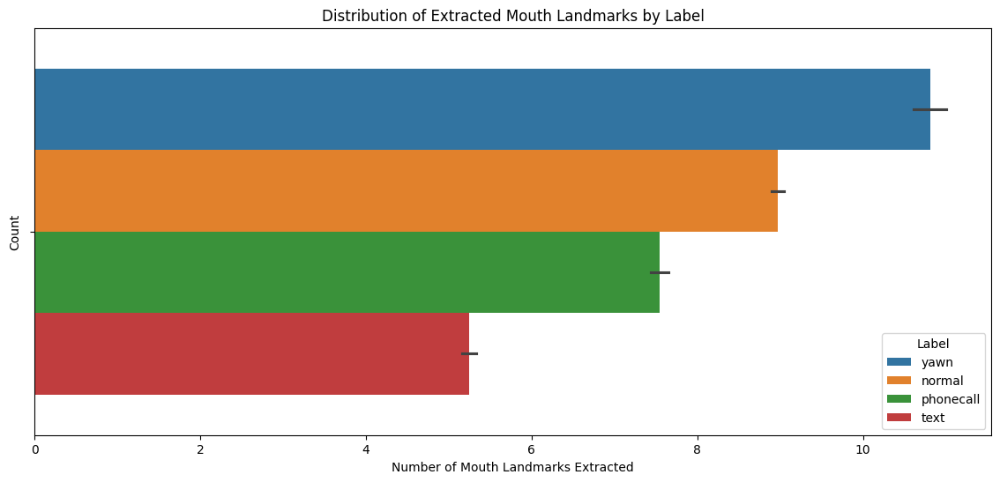

In [ ]:
plt.figure(figsize=(14, 6))
sns.barplot(data=landmark_counts_by_folder, x="count", hue="label")
plt.xlabel("Number of Mouth Landmarks Extracted")
plt.ylabel("Count")
plt.title("Distribution of Extracted Mouth Landmarks by Label")
plt.legend(title="Label")
plt.show()

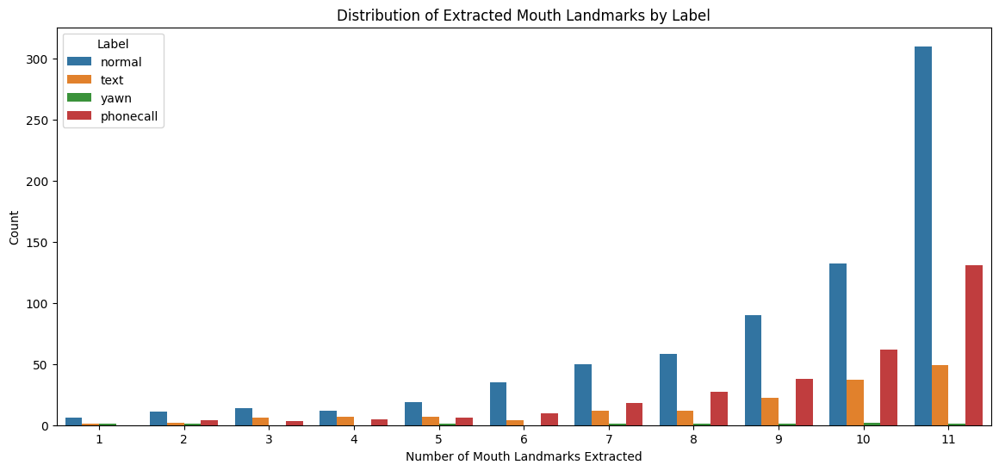

In [ ]:
plt.figure(figsize=(14, 6))
sns.barplot(data=landmark_counts_by_folder[landmark_counts_by_folder['mouth_landmarks']<12], x="mouth_landmarks", y="count", hue="label")
plt.xlabel("Number of Mouth Landmarks Extracted")
plt.ylabel("Count")
plt.title("Distribution of Extracted Mouth Landmarks by Label")
plt.legend(title="Label")
plt.show()

1. 대부분의 데이터에서 12개의 랜드마크가 추출됨
2. 랜드마크가 적게 추출된 경우도 일부 존재

In [ ]:
clip_with_missframe =  landmark_counts_by_folder[(landmark_counts_by_folder['count'] < 12)].reset_index()
clip_with_missframe.sort_values(by='count').head(15) # 오름차순 정렬

,index,video_clip,label,count
3702,7063,gE-28(File18)_s2_face_2019-03-15-10;12;30_28_7...,normal,0
3530,6762,gE-27(File17)_s2_face_2019-03-07-13;05;11_27_1...,normal,0
4549,8486,gF-22(File21)_s3_face_2019-04-09-11;55;31_22_0...,normal,0
8254,14944,gZ-34(File28)_s2_face_2019-04-08-16;46;54_34_0...,normal,0
3328,6280,gE-26(File16)_s3_face_2019-03-15-09;38;23_26_1...,normal,0
6713,12273,gZ-31(File25)_s3_face_2019-04-04-14;50;47_31_1...,normal,0
7573,13804,gZ-33(File27)_s2_face_2019-04-08-09;59;25_33_2...,normal,0
6707,12230,gZ-31(File25)_s3_face_2019-04-04-09;22;00_31_0...,normal,0
1701,3573,gA-5(File5)_s4_face_2019-03-22-11;28;00_5_9.av...,normal,1
1941,4042,gB-6(File6)_s2_face_2019-03-11-13;46;14_6_1.av...,text,1


In [ ]:
clip_with_missframe.reset_index().groupby(['count', 'label'])['index'].count()

count  label    
0      normal          8
1      normal        210
       phonecall      21
       text           34
       yawn            4
2      normal        224
       phonecall      24
       text           34
       yawn            6
3      normal        251
       phonecall      17
       text           45
       yawn            6
4      normal       1548
       phonecall    1337
       text         1343
       yawn            5
5      normal        261
       phonecall      75
       text           65
       yawn            3
6      normal       1154
       phonecall    1060
       text          875
       yawn           89
7      normal        215
       phonecall      46
       text           12
       yawn            5
8      normal        188
       phonecall      29
       text           18
       yawn            3
9      normal        196
       phonecall      38
       text           11
       yawn            6
10     normal        221
       phonecall      37
       text           17
       yawn            3
11     normal        221
       phonecall      36
       text           14
       yawn            5
Name: index, dtype: int64

### 4개 이하로 추출된 video clip 에서 5개 시각화

In [ ]:
low_landmark_clips

array(['1-MaleSunGlasses-Yawning-clip-4_g0',
       '10-FemaleNoGlasses-Yawning-clip-2_g1',
       '11-MaleGlasses-Yawning-clip-3_g4', ...,
       'gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_5.avi_g5',
       'gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_6.avi_g2',
       'gZ-37(File31)_s4_face_2019-04-03-15;40;42_37_9.avi_g9'],
      dtype=object)

In [ ]:
# 해당 video_clip의 모든 프레임을 필터링
low_landmark_clips = clip_with_missframe[clip_with_missframe['count'] <= 4].video_clip.unique()
low_landmark_frames = total_df[total_df["group_id"].isin(low_landmark_clips)]
low_landmark_frames.head()

,frame_path,label,camera,clip_id,frame_no,MAR,MAR_horiz_dist,MAR_vert_mean,mouth_landmarks,EAR,EAR_horiz_dist,EAR_vert_mean,eyes_landmarks,frame_within_cycle,landmark_fail,seq_group,group_id
375,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,1-MaleSunGlasses-Yawning-clip-4,0,0.005992,0.079433,0.000476,"[[0.5486432909965515, 0.5464923977851868], [0....",0.102018,0.051897,0.009735,"[[0.6235857009887695, 0.4054206311702728], [0....",0,0,0,1-MaleSunGlasses-Yawning-clip-4_g0
466,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,10-FemaleNoGlasses-Yawning-clip-2,12,0.174720,0.132744,0.023193,"[[0.37119871377944946, 0.4940085709095001], [0...",0.073797,0.058839,0.008618,"[[0.4602440297603607, 0.35660046339035034], [0...",0,0,1,10-FemaleNoGlasses-Yawning-clip-2_g1
467,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,10-FemaleNoGlasses-Yawning-clip-2,13,0.168680,0.133242,0.022475,"[[0.34299710392951965, 0.49841225147247314], [...",0.075018,0.062338,0.009284,"[[0.43221142888069153, 0.3582528233528137], [0...",1,0,1,10-FemaleNoGlasses-Yawning-clip-2_g1
468,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,10-FemaleNoGlasses-Yawning-clip-2,14,0.144051,0.127974,0.018435,"[[0.3267325162887573, 0.5120038986206055], [0....",0.070459,0.064266,0.009053,"[[0.41007861495018005, 0.36513397097587585], [...",2,0,1,10-FemaleNoGlasses-Yawning-clip-2_g1
811,/content/drive/MyDrive/DMS/data/YawDD dataset/...,normal,mirror,11-MaleGlasses-Yawning-clip-3,48,0.002222,0.091708,0.000204,"[[0.5166963338851929, 0.6021097302436829], [0....",0.111466,0.056111,0.012315,"[[0.5845228433609009, 0.4460771679878235], [0....",0,0,4,11-MaleGlasses-Yawning-clip-3_g4


In [ ]:
len(low_landmark_frames["group_id"].unique())

2457

Exception ignored in: <function _xla_gc_callback at 0x7bdbd820d4e0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/jax/_src/lib/__init__.py", line 96, in _xla_gc_callback
    def _xla_gc_callback(*args):
    
KeyboardInterrupt: 


KeyError: 'file_path'

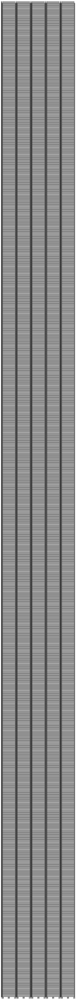

In [ ]:
fig, axes = plt.subplots(len(low_landmark_frames["group_id"].unique()), 5, figsize=(10, 2*70))

for i, (video_clip, group) in enumerate(low_landmark_frames.groupby("group_id")):
    sample_images = group["file_path"].tolist()[:5]  # 각 video_clip 별 최대 5개 이미지 선택
    for j, img_path in enumerate(sample_images):
        img = cv2.imread(img_path)
        if img is not None:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        else:
            img = np.zeros((100, 100, 3), dtype=np.uint8)  # 이미지 로드 실패 시 빈 이미지

        # 랜드마크가 없는 프레임에 빨간색 테두리 표시
        if group.iloc[j]["mouth_landmarks"] is np.nan:
            img = cv2.rectangle(img, (0, 0), (img.shape[1], img.shape[0]), (255, 0, 0), 5)

        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        axes[i, j].set_title(f"{video_clip} - Frame {j+1}")

plt.tight_layout()
plt.show()


### 12 프레임 모두 추출되지 않은 경우

In [ ]:
MAR_frame_count = df.groupby(["video_name", "label"])['MAR'].count().reset_index()
nan_landmark = MAR_frame_count[MAR_frame_count.MAR == 0]
# nan_landmark.to_excel("/content/drive/MyDrive/DMS/nan_landmark.xlsx")
len(nan_landmark)

24

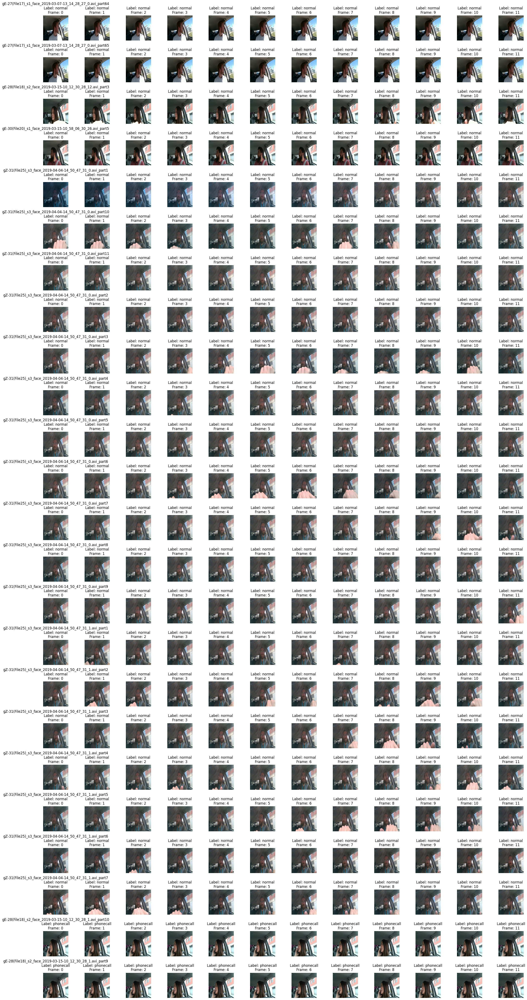

In [ ]:
nan_landmark_ =nan_landmark.merge(df[['video_name', 'label', 'file_path', 'frame']], on=['video_name', 'label'], how='inner')
nan_landmark_.head()
nan_landmark_['file_path'][0]

# 프레임 순서대로 정렬
nan_landmark_sorted = nan_landmark_.sort_values(by=["file_path"])  # 필요 시 정렬 기준 변경

# 12개씩 묶어 출력할 데이터 선택 (총 24세트, 즉 288개 프레임)
selected_rows = nan_landmark_sorted.iloc[:24*12]  # 12개씩 24세트 = 288개 행

# 12개씩 묶어 출력하는 함수
def show_images_in_batches(rows, batch_size=12, num_batches=2):  # 기본적으로 2세트 (24개) 출력
    fig, axes = plt.subplots(num_batches, batch_size, figsize=(batch_size * 2, num_batches * 2))

    for batch in range(num_batches):
        for i in range(batch_size):
            idx = batch * batch_size + i
            if idx >= len(rows):
                axes[batch, i].axis("off")
                continue

            row = rows.iloc[idx]
            img_path = row["file_path"]
            img = cv2.imread(img_path)

            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                axes[batch, i].imshow(img)

                # 12개당 하나의 파일명만 표시 (첫 번째 이미지에만 표시)
                if i == 0:
                    title = f"{row['video_name']}\nLabel: {row['label']}\nFrame: {idx % 12}"
                else:
                    title = f"Label: {row['label']}\nFrame: {idx % 12}"

                axes[batch, i].set_title(title)
                axes[batch, i].axis("off")
            else:
                axes[batch, i].axis("off")

    plt.tight_layout()
    plt.show()

# 이미지 출력
show_images_in_batches(selected_rows, batch_size=12, num_batches=24)  # 12개씩 2세트 (24개) 출력


## 미추출 데이터 보정

In [ ]:
missing_landmarks = df[df["mouth_landmarks"].isna() | df["eye_landmarks"].isna()].index
df.iloc[missing_landmarks]

,file_path,label,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR,left_horizontal_dist,left_vertical_dist,right_horizontal_dist,right_vertical_dist,mouth_landmarks,eye_landmarks,video_clip,frame,video_name,dataset
564,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN,gZ-34(File28)_s2_face_2019-04-08-12_14_28_34_9...,frame000000.jpg,gZ-34(File28)_s2_face_2019-04-08-12_14_28_34_9...,DMD
726,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN,gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0...,frame000018.jpg,gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0...,DMD
730,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN,gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0...,frame000022.jpg,gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0...,DMD
731,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN,gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0...,frame000023.jpg,gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0...,DMD
732,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN,gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0...,frame000024.jpg,gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0...,DMD
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103397,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN,mirror28-MaleGlasses-Yawning-clip-1_part2,frame000018.jpg,mirror28-MaleGlasses-Yawning-clip-1_part2,yawDD
103400,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN,mirror28-MaleGlasses-Yawning-clip-1_part2,frame000022.jpg,mirror28-MaleGlasses-Yawning-clip-1_part2,yawDD
103401,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN,mirror28-MaleGlasses-Yawning-clip-1_part2,frame000021.jpg,mirror28-MaleGlasses-Yawning-clip-1_part2,yawDD
104220,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],NaN,mirror36-MaleSunGlasses-Yawning-clip-1_part1,frame000000.jpg,mirror36-MaleSunGlasses-Yawning-clip-1_part1,yawDD


In [ ]:
df.iloc[564]

,564
file_path,/content/drive/MyDrive/DMS/data/train_test_spl...
label,normal
MAR,NaN
mouth_width,NaN
mouth_height,NaN
left_EAR,NaN
right_EAR,NaN
avg_EAR,NaN
left_horizontal_dist,NaN
left_vertical_dist,NaN


In [ ]:
def interpolate_landmarks(df, column):
    """
    특정 컬럼(column)에 대해 같은 video_name 내에서만 선형 보간을 수행하는 함수
    """
    df[f'{col}_interpolated'] = df.groupby("video_name")[column].transform(lambda x: x.interpolate(limit_direction="both"))
    return df

In [ ]:
df.columns

Index(['file_path', 'label', 'MAR', 'mouth_width', 'mouth_height', 'left_EAR',
       'right_EAR', 'avg_EAR', 'left_horizontal_dist', 'left_vertical_dist',
       'right_horizontal_dist', 'right_vertical_dist', 'mouth_landmarks',
       'eye_landmarks', 'video_name', 'frame'],
      dtype='object')

In [ ]:
inter_cols = ['MAR', 'mouth_width', 'mouth_height', 'left_EAR',
            'right_EAR', 'avg_EAR', 'left_horizontal_dist', 'left_vertical_dist',
            'right_horizontal_dist', 'right_vertical_dist']

df_fixed = df.copy()
for col in inter_cols:
    df_fixed = interpolate_landmarks(df_fixed, col)

In [ ]:
df_fixed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104940 entries, 0 to 104939
Data columns (total 26 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   file_path                           104940 non-null  object 
 1   label                               104940 non-null  object 
 2   MAR                                 101253 non-null  float64
 3   mouth_width                         101253 non-null  float64
 4   mouth_height                        101253 non-null  float64
 5   left_EAR                            101253 non-null  float64
 6   right_EAR                           101253 non-null  float64
 7   avg_EAR                             101253 non-null  float64
 8   left_horizontal_dist                101253 non-null  float64
 9   left_vertical_dist                  101253 non-null  float64
 10  right_horizontal_dist               101253 non-null  float64
 11  right_vertical_dist       

In [ ]:
df_fixed[df_fixed['MAR_interpolated'].isnull()].video_name[13284]

'gZ-31(File25)_s3_face_2019-04-04-14_50_47_31_0.avi_part1'

In [ ]:
df_fixed.to_csv("/content/drive/MyDrive/DMS/data/EDA/mar_results/MAR_EAR_interpolated.csv", index=False)

### 선형 보간 및 저장

In [ ]:
def visualize_interpolation(df, label, video_name):
    """
    특정 label과 video_name에 대해 선형 보간 전후의 yaw와 pitch 데이터를 시각화합니다.

    Args:
        df (pd.DataFrame): 원본 데이터프레임.
        label (str): 대상 라벨.
        video_name (str): 대상 비디오 이름.

    Returns:
        None
    """
    # 대상 데이터 필터링
    filtered_df = df[(df['label'] == label) & (df['video_name'] == video_name)].sort_values(by='frame').reset_index(drop=True)

    # 모든 frame 값을 확보
    all_frames = filtered_df['frame']

    # 시각화
    fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # 2x2 서브플롯 생성

    # MAR - before
    axes[0, 0].scatter(filtered_df['frame'], filtered_df['MAR'], label='Original MAR', color='blue')  # 마커만 표시
    axes[0, 0].plot(filtered_df['frame'], filtered_df['MAR'], linestyle='--', color='blue', alpha=0.5)  # 선 추가
    axes[0, 0].set_title("MAR - Before Interpolation", fontsize=14)
    axes[0, 0].set_ylabel("MAR", fontsize=12)
    axes[0, 0].set_xlabel("Frame", fontsize=12)
    axes[0, 0].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[0, 0].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[0, 0].legend(fontsize=10)

    # MAR - after
    axes[0, 1].plot(filtered_df['frame'], filtered_df['MAR_interpolated'], 'o-', label='Interpolated MAR', color='orange')
    axes[0, 1].set_title("MAR - After Interpolation", fontsize=14)
    axes[0, 1].set_ylabel("MAR_interpolated", fontsize=12)
    axes[0, 1].set_xlabel("Frame", fontsize=12)
    axes[0, 1].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[0, 1].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[0, 1].tick_params(axis='y', labelleft=False)  # y축 레이블 숨김
    axes[0, 1].legend(fontsize=10)

    # avg_EAR - before
    axes[1, 0].scatter(filtered_df['frame'], filtered_df['avg_EAR'], label='Original Pitch', color='blue')  # 마커만 표시
    axes[1, 0].plot(filtered_df['frame'], filtered_df['avg_EAR'], linestyle='--', color='blue', alpha=0.5)  # 선 추가
    axes[1, 0].set_title("avg_EAR - Before Interpolation", fontsize=14)
    axes[1, 0].set_ylabel("avg_EAR", fontsize=12)
    axes[1, 0].set_xlabel("Frame", fontsize=12)
    axes[1, 0].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[1, 0].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[1, 0].legend(fontsize=10)

    # avg_EAR - after
    axes[1, 1].plot(filtered_df['frame'], filtered_df['avg_EAR_interpolated'], 'o-', label='Interpolated avg_EAR', color='orange')
    axes[1, 1].set_title("avg_EAR - After Interpolation", fontsize=14)
    axes[1, 0].set_ylabel("avg_EAR_interpolated", fontsize=12)
    axes[1, 1].set_xlabel("Frame", fontsize=12)
    axes[1, 1].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[1, 1].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[1, 1].tick_params(axis='y', labelleft=False)  # y축 레이블 숨김
    axes[1, 1].legend(fontsize=10)

    # 전체 제목 추가 및 레이아웃 조정
    fig.suptitle(f"Interpolation for Label: {label}, Video: {video_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # 제목과 그래프 간격 조정
    plt.show()

In [ ]:
def interpolate_and_save(df, output_dir):
    """
    df 데이터를 label_dataset, video_name, frame 순서대로 정렬 후 선형 보간하고,
    label_dataset별로 CSV 파일로 저장합니다.

    Args:
        df (pd.DataFrame): 원본 데이터프레임.
        output_dir (str): 결과 CSV 파일을 저장할 디렉토리 경로.

    Returns:
        None
    """
    # label_dataset 컬럼 생성
    if 'label_dataset' not in df.columns:
        df['label_dataset'] = df['label'] + '_' + df['dataset']

    # 데이터 정렬
    df = df.sort_values(by=['label_dataset', 'video_name', 'frame']).reset_index(drop=True)

    # 그룹별 보간 함수 정의
    def interpolate_group(group):
        group['MAR'] = group['MAR'].interpolate(method='linear', limit_direction='both')
        group['avg_EAR'] = group['avg_EAR'].interpolate(method='linear', limit_direction='both')
        return group

    # 출력 디렉토리 생성
    os.makedirs(output_dir, exist_ok=True)

    # label_dataset별로 그룹화하여 보간 수행 및 CSV 저장
    for label_dataset, group in df.groupby('label_dataset'):
        interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)
        output_file = os.path.join(output_dir, f"{label_dataset}.csv")
        try:
            interpolated_group.to_csv(output_file, index=False)
            print(f"Successfully saved interpolated data to {output_file}")
        except Exception as e:
            print(f"Error saving interpolated data for {label_dataset}: {e}")


In [ ]:
# test_df = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results/mar_ear_test.csv")
output_dir = '/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test'
save_columns = ['label', 'video_name', 'frame', 'MAR', 'avg_EAR', 'mouth_landmarks', 'eye_landmarks', 'dataset']
interpolate_and_save(test_df[save_columns], output_dir)

<ipython-input-43-0e46b36ecad0>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['label_dataset'] = df['label'] + '_' + df['dataset']
<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/normal_DMD.csv
Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/normal_yawDD.csv


<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)
<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/phonecall_DMD.csv


<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/text_DMD.csv
Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/yawn_yawDD.csv


<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


In [ ]:
test_df

,file_path,label,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR,left_horizontal_dist,left_vertical_dist,right_horizontal_dist,right_vertical_dist,mouth_landmarks,eye_landmarks,video_name,frame,dataset
0,/content/drive/MyDrive/DMS/data/train_test_spl...,normal_DMD,0.037991,0.058222,0.002212,0.144759,0.143627,0.144193,0.041403,0.011987,0.042361,0.012168,"[(0.4469671845436096, 0.7180995941162109), (0....","[(0.5017154216766357, 0.5785568952560425), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000036,gA-1(File1)
1,/content/drive/MyDrive/DMS/data/train_test_spl...,normal_DMD,0.042869,0.060097,0.002576,0.149791,0.144543,0.147167,0.041988,0.012579,0.044379,0.012829,"[(0.4483779966831207, 0.7193543910980225), (0....","[(0.5097396969795227, 0.5809462666511536), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000037,gA-1(File1)
2,/content/drive/MyDrive/DMS/data/train_test_spl...,normal_DMD,0.041641,0.058848,0.002451,0.126139,0.128921,0.127530,0.041612,0.010498,0.043372,0.011183,"[(0.4492361843585968, 0.7198998332023621), (0....","[(0.5107419490814209, 0.5833330154418945), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000038,gA-1(File1)
3,/content/drive/MyDrive/DMS/data/train_test_spl...,normal_DMD,0.024705,0.057388,0.001418,0.103966,0.099685,0.101826,0.038369,0.007978,0.041208,0.008216,"[(0.4510745406150818, 0.7180595993995667), (0....","[(0.5156036615371704, 0.5881567001342773), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000039,gA-1(File1)
4,/content/drive/MyDrive/DMS/data/train_test_spl...,normal_DMD,0.034081,0.052281,0.001782,0.146873,0.143660,0.145267,0.039280,0.011538,0.042292,0.012151,"[(0.4536834955215454, 0.718080461025238), (0.4...","[(0.5108946561813354, 0.5815122127532959), (0....",gA-1(File1)_s3_face_2019-03-14-14_31_08_1_2.av...,frame000040,gA-1(File1)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23563,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn_yawDD_0309,0.315766,0.098810,0.031201,0.154270,0.107320,0.130795,0.053380,0.016470,0.084102,0.018052,"[(0.5699644684791565, 0.4372181296348572), (0....","[(0.6232001781463623, 0.1989552080631256), (0....",mirror9-MaleNoGlasses-Yawning-clip-3_part3,frame000028,mirror9-MaleNoGlasses-Yawning-clip-3
23564,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn_yawDD_0309,0.031771,0.106896,0.003396,0.150393,0.107864,0.129128,0.056337,0.016945,0.084756,0.018284,"[(0.5624699592590332, 0.4468122720718384), (0....","[(0.6305323243141174, 0.20895424485206604), (0...",mirror9-MaleNoGlasses-Yawning-clip-3_part3,frame000034,mirror9-MaleNoGlasses-Yawning-clip-3
23565,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn_yawDD_0309,0.030392,0.104060,0.003163,0.157754,0.109369,0.133561,0.054675,0.017250,0.083893,0.018351,"[(0.5623183846473694, 0.43609729409217834), (0...","[(0.6254308223724365, 0.20248718559741974), (0...",mirror9-MaleNoGlasses-Yawning-clip-3_part3,frame000032,mirror9-MaleNoGlasses-Yawning-clip-3
23566,/content/drive/MyDrive/DMS/data/train_test_spl...,yawn_yawDD_0309,0.029476,0.106897,0.003151,0.153963,0.108868,0.131415,0.055583,0.017115,0.084281,0.018351,"[(0.5645121335983276, 0.44427376985549927), (0...","[(0.6327046751976013, 0.21399390697479248), (0...",mirror9-MaleNoGlasses-Yawning-clip-3_part3,frame000035,mirror9-MaleNoGlasses-Yawning-clip-3


In [ ]:
output_dir = '/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated'
save_columns = ['label', 'video_name', 'frame', 'MAR', 'avg_EAR', 'mouth_landmarks', 'eye_landmarks', 'dataset']
interpolate_and_save(df[save_columns], output_dir)

<ipython-input-43-0e46b36ecad0>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['label_dataset'] = df['label'] + '_' + df['dataset']
<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/normal_DMD.csv


<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/normal_yawDD.csv


<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/phonecall_DMD.csv


<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/text_DMD.csv


<ipython-input-43-0e46b36ecad0>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/yawn_yawDD.csv


In [ ]:
save_columns = ['label', 'video_name', 'frame', 'MAR', 'avg_EAR', 'mouth_landmarks', 'eye_landmarks', 'dataset']
df[save_columns].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104940 entries, 0 to 104939
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   label            104940 non-null  object 
 1   video_name       104940 non-null  object 
 2   frame            104940 non-null  object 
 3   MAR              101253 non-null  float64
 4   avg_EAR          101253 non-null  float64
 5   mouth_landmarks  104940 non-null  object 
 6   eye_landmarks    101253 non-null  object 
 7   dataset          104940 non-null  object 
dtypes: float64(2), object(6)
memory usage: 6.4+ MB


### 저장된 데이터 확인

- yaw-pitch

In [ ]:
normal_DMD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/normal_DMD.csv")
normal_yawDD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/normal_yawDD.csv")
phonecall_DMD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/phonecall_DMD.csv")
text_DMD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/text_DMD.csv")
yawn_yawDD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/yawn_yawDD.csv")

yaw_pitch_df = pd.concat([normal_DMD, normal_yawDD, phonecall_DMD, text_DMD, yawn_yawDD], axis=0)
yaw_pitch_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 104940 entries, 0 to 4403
Data columns (total 10 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   label          104940 non-null  object 
 1   video_name     104940 non-null  object 
 2   frame          104940 non-null  object 
 3   pitch          104940 non-null  float64
 4   yaw            104940 non-null  float64
 5   bbox           104833 non-null  object 
 6   landmarks      104833 non-null  object 
 7   score          104833 non-null  float64
 8   dataset        104940 non-null  object 
 9   label_dataset  104940 non-null  object 
dtypes: float64(3), object(7)
memory usage: 8.8+ MB


In [ ]:
yaw_pitch_df.columns

Index(['label', 'video_name', 'frame', 'pitch', 'yaw', 'bbox', 'landmarks',
       'score', 'dataset', 'label_dataset'],
      dtype='object')

In [ ]:
yaw_pitch_df.head()

,label,video_name,frame,pitch,yaw,bbox,landmarks,score,dataset,label_dataset
0,normal,gB-10(File10)_s1_face_2019-03-11-15_24_54_10_0...,frame000000.jpg,-0.802380,-0.178544,[ 86.03364 65.879135 143.4479 162.76117 ],[[115.35201 99.411316]\n [129.58809 96.632...,0.991986,DMD,normal_DMD
1,normal,gB-10(File10)_s1_face_2019-03-11-15_24_54_10_0...,frame000001.jpg,-0.258022,-0.444779,[ 85.94774 69.89338 141.70164 173.82745],[[108.4074 108.82792]\n [128.76982 108.30778]...,0.982868,DMD,normal_DMD
2,normal,gB-10(File10)_s1_face_2019-03-11-15_24_54_10_0...,frame000002.jpg,0.173530,-0.746606,[ 83.76038 74.02278 142.2394 178.90962],[[104.08678 114.05342 ]\n [128.643 115.441...,0.980093,DMD,normal_DMD
3,normal,gB-10(File10)_s1_face_2019-03-11-15_24_54_10_0...,frame000003.jpg,-0.022168,-0.725515,[ 84.322174 75.72479 141.48697 181.58836 ],[[102.33694 116.483734]\n [126.94715 117.517...,0.973711,DMD,normal_DMD
4,normal,gB-10(File10)_s1_face_2019-03-11-15_24_54_10_0...,frame000004.jpg,-0.187156,-0.672688,[ 83.90695 74.74411 141.61597 182.33232],[[103.035934 115.61689 ]\n [126.724915 116.420...,0.970456,DMD,normal_DMD


- mar,ear - train

In [ ]:
normal_DMD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/normal_DMD.csv")
normal_yawDD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/normal_yawDD.csv")
phonecall_DMD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/phonecall_DMD.csv")
text_DMD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/text_DMD.csv")
yawn_yawDD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated/yawn_yawDD.csv")

mar_ear_df = pd.concat([normal_DMD, normal_yawDD, phonecall_DMD, text_DMD, yawn_yawDD], axis=0)
mar_ear_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 104940 entries, 0 to 4403
Data columns (total 9 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   label            104940 non-null  object 
 1   video_name       104940 non-null  object 
 2   frame            104940 non-null  object 
 3   MAR              104652 non-null  float64
 4   avg_EAR          104652 non-null  float64
 5   mouth_landmarks  104940 non-null  object 
 6   eye_landmarks    101253 non-null  object 
 7   dataset          104940 non-null  object 
 8   label_dataset    104940 non-null  object 
dtypes: float64(2), object(7)
memory usage: 8.0+ MB


In [ ]:
104940 - 104652

288

In [ ]:
288/12

24.0

In [ ]:
104940/12

8745.0

In [ ]:
df_fixed.label.unique()

array(['normal_DMD', 'normal_yawDD_0309', 'phonecall_DMD', 'text_DMD',
       'yawn_yawDD_0309'], dtype=object)

In [ ]:
df_fixed

In [ ]:
df_fixed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104940 entries, 0 to 104939
Data columns (total 26 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   file_path                           104940 non-null  object 
 1   label                               104940 non-null  object 
 2   MAR                                 101253 non-null  float64
 3   mouth_width                         101253 non-null  float64
 4   mouth_height                        101253 non-null  float64
 5   left_EAR                            101253 non-null  float64
 6   right_EAR                           101253 non-null  float64
 7   avg_EAR                             101253 non-null  float64
 8   left_horizontal_dist                101253 non-null  float64
 9   left_vertical_dist                  101253 non-null  float64
 10  right_horizontal_dist               101253 non-null  float64
 11  right_vertical_dist       

In [ ]:
label = "normal_DMD" # 결측치 6개 - 초반에 손으로 카메라를 가리는 6 프레임
# video_name = "gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0.avi_part3"
video_name = "gZ-31(File25)_s3_face_2019-04-04-14_50_47_31_0.avi_part1"
visualize_interpolation(df_fixed, label, video_name)

In [ ]:
df.head()

,file_path,label,MAR,mouth_width,mouth_height,left_EAR,right_EAR,avg_EAR,left_horizontal_dist,left_vertical_dist,right_horizontal_dist,right_vertical_dist,mouth_landmarks,eye_landmarks,video_clip,frame,video_name,dataset
0,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.376466,0.061949,0.023322,0.128341,0.148426,0.138383,0.040436,0.010379,0.035620,0.01057394940203409,"[(0.45304083824157715, 0.6389512419700623), (0...","[(0.49451518058776855, 0.5022357702255249), (0...",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000000.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD
1,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.243979,0.051054,0.012456,0.140002,0.114637,0.127319,0.031794,0.008902,0.042943,0.00984574098818084,"[(0.5035773515701294, 0.6430702805519104), (0....","[(0.5539824962615967, 0.5103051662445068), (0....",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000001.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD
2,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.304681,0.060706,0.018496,0.145839,0.135531,0.140685,0.040352,0.011770,0.044131,0.011962201728150868,"[(0.513645589351654, 0.6414036750793457), (0.5...","[(0.5763875246047974, 0.5118524432182312), (0....",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000002.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD
3,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.247592,0.066301,0.016416,0.158701,0.122808,0.140755,0.035250,0.011188,0.047811,0.011743132293623771,"[(0.532393217086792, 0.6401354670524597), (0.5...","[(0.6063141226768494, 0.5204540491104126), (0....",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000003.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD
4,/content/drive/MyDrive/DMS/data/train_test_spl...,normal,0.047304,0.044065,0.002084,0.184732,0.133173,0.158952,0.027288,0.010082,0.040468,0.010778612528080657,"[(0.5485552549362183, 0.6214728951454163), (0....","[(0.5956661701202393, 0.5139091610908508), (0....",gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000004.jpg,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,DMD


- mar_ear - test

In [ ]:
normal_DMD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/normal_DMD.csv")
normal_yawDD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/normal_yawDD.csv")
phonecall_DMD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/phonecall_DMD.csv")
text_DMD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/text_DMD.csv")
yawn_yawDD = pd.read_csv("/content/drive/MyDrive/DMS/data/EDA/mar_ear_results_interpolated_test/yawn_yawDD.csv")

mar_ear_test = pd.concat([normal_DMD, normal_yawDD, phonecall_DMD, text_DMD, yawn_yawDD], axis=0)
mar_ear_test.info()

<class 'pandas.core.frame.DataFrame'>
Index: 23568 entries, 0 to 1211
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   label            23568 non-null  object 
 1   video_name       23568 non-null  object 
 2   frame            23568 non-null  object 
 3   MAR              23544 non-null  float64
 4   avg_EAR          23544 non-null  float64
 5   mouth_landmarks  23568 non-null  object 
 6   eye_landmarks    23076 non-null  object 
 7   dataset          23568 non-null  object 
 8   label_dataset    23568 non-null  object 
dtypes: float64(2), object(7)
memory usage: 1.8+ MB


In [ ]:
23568- 23544

24

In [ ]:
mar_ear_test[mar_ear_test.MAR.isnull()].video_name.unique()

array(['gB-6(File6)_s4_face_2019-03-20-13_42_00_6_3.avi_part7',
       'gB-6(File6)_s4_face_2019-03-20-13_42_00_6_3.avi_part8'],
      dtype=object)

## 2. 밝기 조절로 개선이 되는지 확인

In [ ]:
def adjust_brightness(image_path, alpha=1.5, beta=30):
    img = cv2.imread(image_path)
    if img is None:
        return None
    adjusted = cv2.convertScaleAbs(img, alpha=alpha, beta=beta)  # 밝기 조절
    return adjusted

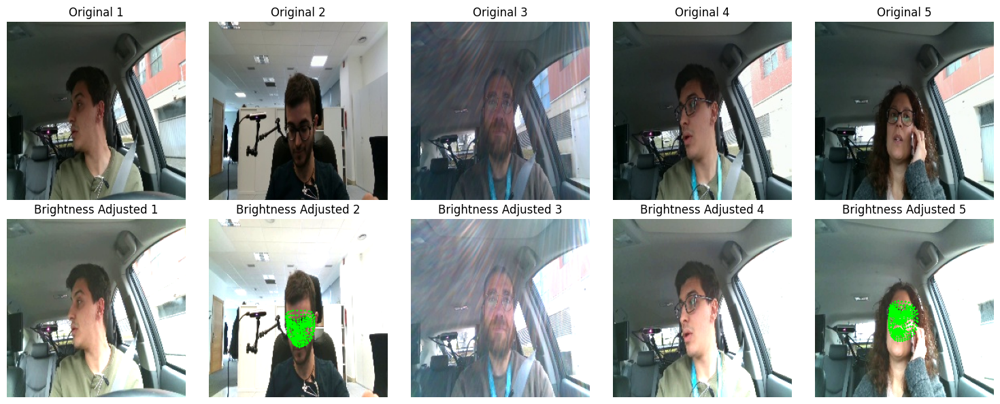

In [ ]:
# MediaPipe Face Mesh 설정
mp_face_mesh = mp.solutions.face_mesh
face_mesh = mp_face_mesh.FaceMesh(static_image_mode=True, max_num_faces=1, refine_landmarks=True)

# 랜덤으로 랜드마크 추출 실패한 이미지 5개 샘플링
missing_samples = df[df["mouth_landmarks"] == '[]']["file_path"].sample(n=5, random_state=42).tolist()

fig, axes = plt.subplots(2, 5, figsize=(15, 6))

for i, img_path in enumerate(missing_samples):
    original = cv2.imread(img_path)
    if original is not None:
        original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
        adjusted = adjust_brightness(img_path)

        def apply_face_mesh(image):
            img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            results = face_mesh.process(img_rgb)
            if results.multi_face_landmarks:
                for face_landmarks in results.multi_face_landmarks:
                    for landmark in face_landmarks.landmark:
                        h, w, _ = image.shape
                        x, y = int(landmark.x * w), int(landmark.y * h)
                        cv2.circle(image, (x, y), 1, (0, 255, 0), -1)
            return image
        # 랜드마크 적용된 이미지
        if adjusted is not None:
            adjusted_with_landmarks = apply_face_mesh(adjusted)
            adjusted_with_landmarks = cv2.cvtColor(adjusted_with_landmarks, cv2.COLOR_BGR2RGB)
        # 원본 이미지 출력
        axes[0, i].imshow(original)
        axes[0, i].axis("off")
        axes[0, i].set_title(f"Original {i+1}")
        # 조정된 이미지 + Face Mesh 적용
        if adjusted is not None:
            adjusted = cv2.cvtColor(adjusted, cv2.COLOR_BGR2RGB)
            axes[1, i].imshow(adjusted)
            axes[1, i].axis("off")
            axes[1, i].set_title(f"Brightness Adjusted {i+1}")

plt.tight_layout()
plt.show()

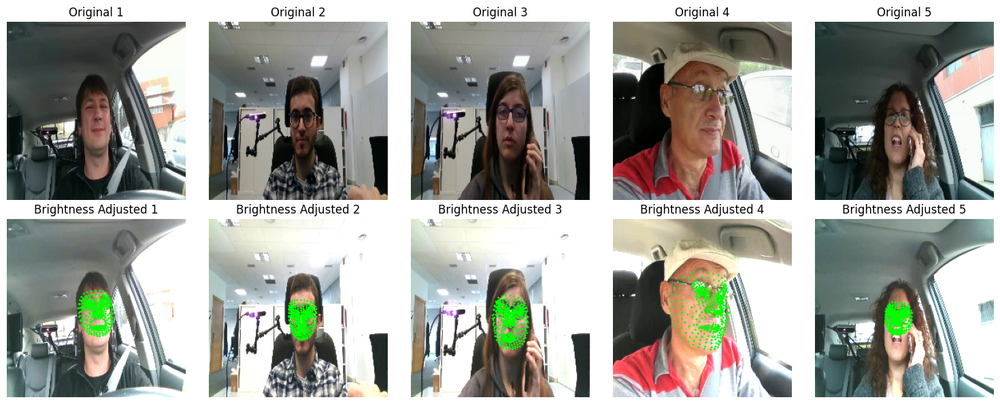

In [ ]:
# MediaPipe Face Mesh 설정
mp_face_mesh = mp.solutions.face_mesh
face_mesh = mp_face_mesh.FaceMesh(static_image_mode=True, max_num_faces=1, refine_landmarks=True)

# 랜덤으로 랜드마크 추출 실패한 이미지 5개 샘플링
missing_samples = df[df["mouth_landmarks"] != '[]']["file_path"].sample(n=5, random_state=30).tolist()

fig, axes = plt.subplots(2, 5, figsize=(15, 6))

for i, img_path in enumerate(missing_samples):
    original = cv2.imread(img_path)
    if original is not None:
        original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
        adjusted = adjust_brightness(img_path)

        def apply_face_mesh(image):
            img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            results = face_mesh.process(img_rgb)
            if results.multi_face_landmarks:
                for face_landmarks in results.multi_face_landmarks:
                    for landmark in face_landmarks.landmark:
                        h, w, _ = image.shape
                        x, y = int(landmark.x * w), int(landmark.y * h)
                        cv2.circle(image, (x, y), 1, (0, 255, 0), -1)
            return image

        # 랜드마크 적용된 이미지
        if adjusted is not None:
            adjusted_with_landmarks = apply_face_mesh(adjusted)
            adjusted_with_landmarks = cv2.cvtColor(adjusted_with_landmarks, cv2.COLOR_BGR2RGB)
        # 원본 이미지 출력
        axes[0, i].imshow(original)
        axes[0, i].axis("off")
        axes[0, i].set_title(f"Original {i+1}")
        # 조정된 이미지 + Face Mesh 적용
        if adjusted is not None:
            adjusted = cv2.cvtColor(adjusted, cv2.COLOR_BGR2RGB)
            axes[1, i].imshow(adjusted)
            axes[1, i].axis("off")
            axes[1, i].set_title(f"Brightness Adjusted {i+1}")

plt.tight_layout()
plt.show()

In [ ]:
def auto_adjust_brightness(image, target_brightness=128):
    """
    이미지의 평균 밝기를 측정하고, target_brightness에 맞춰 조정하는 함수
    :param image: 입력 이미지 (numpy array)
    :param target_brightness: 목표 밝기 (0~255 사이 값, 기본 128)
    :return: 밝기 조정된 이미지
    """
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # 흑백 변환
    mean_brightness = np.mean(gray)  # 현재 밝기 계산

    # 밝기 조절 계수 계산 (1.0을 중심으로)
    alpha = target_brightness / mean_brightness
    adjusted = cv2.convertScaleAbs(image, alpha=alpha, beta=0)  # beta는 0으로 고정
    return adjusted

<ipython-input-56-118e52735eb7>:49: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=summary, x="Change Type", y="Count", palette="coolwarm")


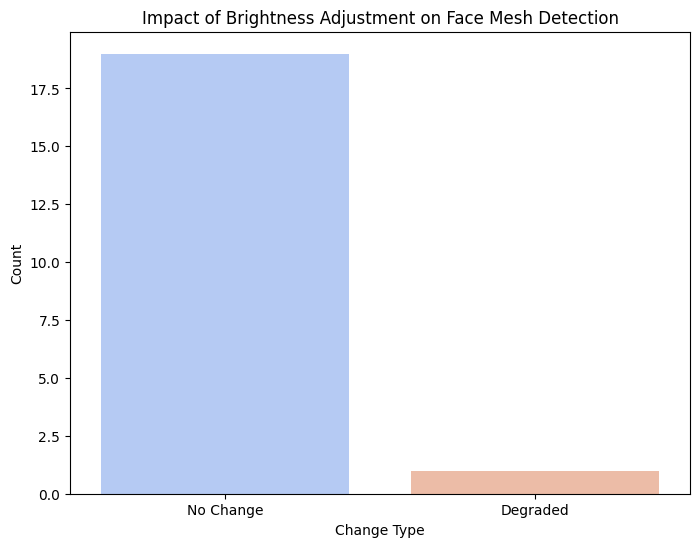

In [ ]:
import random

# 랜덤 샘플링 (20개 정도 선택)
sampled_files = df["file_path"].sample(n=20, random_state=42).tolist()

# Face Mesh 랜드마크 개수 계산 함수
def count_landmarks(image):
    img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    results = face_mesh.process(img_rgb)
    if results.multi_face_landmarks:
        return sum(1 for _ in results.multi_face_landmarks[0].landmark)
    return 0  # 감지되지 않으면 0

# 결과 저장용 리스트
results = []

for img_path in sampled_files:
    original = cv2.imread(img_path)
    if original is None:
        continue

    # 원본 이미지 랜드마크 개수
    original_landmarks = count_landmarks(original.copy())

    # 밝기 조절 이미지 랜드마크 개수
    adjusted = adjust_brightness(img_path)
    if adjusted is not None:
        adjusted_landmarks = count_landmarks(adjusted.copy())
    else:
        adjusted_landmarks = 0

    # 감지 여부 변화 기록
    results.append({
        "file_path": img_path,
        "original_landmarks": original_landmarks,
        "adjusted_landmarks": adjusted_landmarks,
        "status": "Improved" if adjusted_landmarks > original_landmarks else "Degraded" if adjusted_landmarks < original_landmarks else "No Change"
    })

# 결과 데이터프레임 생성
df_results = pd.DataFrame(results)

# 통계 요약
summary = df_results["status"].value_counts().reset_index()
summary.columns = ["Change Type", "Count"]

# 시각화
plt.figure(figsize=(8, 6))
sns.barplot(data=summary, x="Change Type", y="Count", palette="coolwarm")
plt.xlabel("Change Type")
plt.ylabel("Count")
plt.title("Impact of Brightness Adjustment on Face Mesh Detection")
plt.show()


In [ ]:
summary

,Change Type,Count
0,No Change,19
1,Degraded,1


In [ ]:
f